# Свёрточные сети

Сегодня мы детальнее поговорим про общие подходы при обучении нейросетей, и что происходит внутри них.

<img width='400px' src='https://raw.githubusercontent.com/sslotin/universum-dl/43390d26d5f256dcc68a6ba51998bd626b3f6d33/images/cat.png'>

Если попытаться визуализировать то, что выучивает каждый нейрон в нейросети (например, посмотрев, какие входные пиксели на него сильнее всего влияют), то можно увидеть, что чем глубже находится слой, тем более абстрактные фичи он содержит.

Например, в сетях для распознавания картинок первые слои учатся обнаруживать геометрические примитивы: линии, границы, углы. Следующий слой может распознавать простые геометрические фигуры. Следующий распознаёт наличие целых объектов и т. д.

**Weight sharing**. [Эксперименты с дропаутом](https://arxiv.org/abs/1701.05369) показывают, что в линейном слое примерно 99% весов на самом деле можно выкинуть. Логично, что в оптимальной архитектуре не должно быть бесполезных весов — лишние параметры всегда ведут к переобучению. В случае с картинками решение в том, чтобы использовать информацию о расположении пикселей относительно друг друга.

## Свёртки и пуллинги

**Как хранятся картинки**. Когда говорят «изображение», представляйте не прямоугольник, а параллелепипед, высотой которого будет размер каналов. Например, обычные цветные RGB картинки имеют 3 канала: на красный (R), зелёный (G) и синий (B).

0. Введем такую функцию, как **ядро** (англ. **kernel**) — она считает скалярное произведение вектора-входа со своим вектором-параметром.
1. Разобьем исходный паралеллелепипед на сколько-то параллелепипедов одинакового размера вдоль размерности, соответствующей каналам. Они могут пересекаться.
2. Каждый из них «разгладим» в вектор.
3. К кажому такому вектору и применим по очереди каждый кернел (их обычно берут много разных).
4. Положим то, что получилось, в новый параллелепипед.
5. Посчитаем для кажой ячейки какую-нибудь нелинейность. Обычно это ReLU из-за вычислительных причин.

<img width='350px' src='https://raw.githubusercontent.com/sslotin/universum-dl/43390d26d5f256dcc68a6ba51998bd626b3f6d33/images/conv1.png'>

Эта операция называется **свёрткой**. Помимо кернела, в ней есть другие параметры — паддинг (отступ по краям), страйды (шаги по x и y). Также свёртка может быть в 2d и 3d. Посмотрите этот репозиторий, чтобы получше разобраться со свёрточной арифметикой: https://github.com/vdumoulin/conv_arithmetic

![](http://deeplearning.net/software/theano/_images/numerical_padding_strides.gif)

**Пулингом** называют операцию, при которой входной тензор так же разбивается на квадраты (не паралепипеды — операция независима по каждому каналу) и на каждом квадрате считается какая-нибудь редукция (чаще всего максимум или среднее по всем значениям в квадрате), после чего полученные значения записываются на следующий слой в том же порядке.

<img width='400px' src='http://cs231n.github.io/assets/cnn/maxpool.jpeg'>

В свёртках переиспользуется очень много параметров: кернел для каждого фильтра (выходного канала) использует один и тот же вектор-параметр для скалярного умножения. Из-за этого каждый фильтр как правило выучивает какую-то конкретную фичу, вроде наличия какого-либо объекта на своём регионе. Пулинг используют затем для понижения размерности: каждый нейрон после свертки выражает степень уверенности, что на регионе присутствует какой-то объект, и поэтому логично в качестве вероятности наличия объекта на регионе из под-регионов использовать максимум или среднее.

Чаще всего используют свёртки 3x3 со страйдом 2x2 (то есть квадраты перекрываются по 3 крайним пикселям) с пулингом размера 2x2 (не перекрываются).

## Аугментация данных

Аугментацией называется процесс получения новых синтетических данных из имеющихся, чтобы подать в обучение. Это часто (особенно в компьютерном зрении) позволяет улучшить качество модели, не используя дополнительных данных.

Формально, в случае с классификацией, аугментация — это любое преобразование, которое корректно изменяет данные, не меняя их класс.

В случае с картинками, можно попробовать добавить следующие преобразования, которые с какой-то вероятностью будут использоваться во время обучения:

* Поворот на малый угол.
* Добавление шума.
* Обрезание границ и последующее растяжение до исходного размера.
* Горизонтальное отражение (но в нашем случае оно вредно).
* Смещение на небольшое расстояние.

Понятно, что лейбл эти преобразования изменить не должны.

<img src='https://ai2-s2-public.s3.amazonaws.com/figures/2017-08-08/a5da2c3b4174449d13dd746b7d00897c6bc1f334/5-Figure2-1.png' width='500px'>

## Взрывающийся градиент

В сетях происходит очень много чего стохастического: батч формируется случайно, аугментация, рандомизированные слои вроде дропаута, вычислительные ошибки. Это всё может привести к тому, что сеть на какой-то итерации будет очень уверенна в неправильном предсказании и некоторые её параметры получат очень большой градиент. Это может привести к тому, что эти параметры «улетят» куда-то настолько далеко, и после этого сеть будет всегда предсказывать класс, который на этой итерации был правильным. 

Простое решение: просто обрезать градиент в случае, если градиент больше какого-то фиксированного значения. Для этого есть функция `torch.nn.utils.clip_grad_norm_`, которая принимает параметры модели и параметр `threshold`. Она считает норму (длину вектора) градиента и, если она больше `threshold`, нормирует градиенты так, чтобы она была равна `threshold`. Эта функция также возвращает само значение нормы, что может быть очень полезно при анализе обучения (например, если она становится маленькой, то, значит, сеть сходится к какому-то плато).

## Инициализация параметров

Сначала приведем пример плохой инициализации. Пусть мы задали все значения изначально нулями. В таком случае наша модель становится эквивалентна линейной модели — производная по функции потерь одинакова для каждого $w_i$, таким образом, все веса имеют одинаковые значения и в последующей итерации, что делает нейроны в сети симметричными.

Подход получше — инициализировать каждый вес случайно. Но тут нужно быть осторожным — если задать их слишком большими, то сеть может быть изначально очень уверенна в своих предсказаниях, и подвинуть параметры оттуда будет очень трудно.

Решение следующее. С точки зрения слоя, ему на вход подается сэмпл из какого-то распределения, и он под это распределение подстраивается. В нейросетях размеры слоев достаточно большие, чтобы в них работали законы статистики, все разработчики фреймворках условились инициализировать веса всех слоев в предположении, что на вход подаются данные из какого-то распределения со средним 0 и дисперсией 1, и на выходе должно получиться какое-то распределение со средним тоже 0 и дисперсией 1. Чаще всего изначальные веса берут либо из нормального, либо из равномерного распределения, «обрезанного» так, чтобы дисперсия каждого выходного значения получилась единичной.

Аналогично нужно поступать со входными векторными данными: нормализовывать. Это будет важно при работе с изображениями: не надо подавать на вход вектора с элементами от 0 до 255. Самое простое рабочее решение — нормализовать вход, поделив его на 255.

## Минутка физики

Потребляемая энергия в сети с переменным током в единицу времени считается по формуле

$$W = CV^2f$$

где $C$ означает емкость сети, $V$ означает напряжение, а $f$ — частоту. В случае с процессорами, это именно та частота, с которой выполняются элементарные операции, например сложение.

<img width='350px' src='https://i.ibb.co/yhsGRJK/Screenshot-from-2019-02-08-14-52-07.png'>

Однако, если мы сделаем сеть из двух параллельно подключенных процессоров, работающих на половинной частоте, мы можем получить сеть, потребляющую ~40% изначальной энергии, делающую то же количество полезной работы — то же суммарное количество процессорных тактов:

<img width='450px' src='https://i.ibb.co/WgLCxxL/Screenshot-from-2019-02-08-14-52-18.png'>

Поэтому для хорошо распараллеливаемых операций используют другой тип вычислительных устройств, в которых не 4-8 быстрых (3-4 GHz) процессоров, а несколько тысяч медленных (~1GHz).

## Device-agnostic код

К любой модели или тензору в PyTorch можно применить `.cuda()` и `.cpu()`, чтобы перевести тензор на память GPU или в оперативную память соответственно. Но если мы будем писать такой код, нам будет довольно проблематично портировать его на другие машины, где, например, нет GPU (например, если вы хотите скачать тетрадку с colab к себе и запустить).

Многие фреймворки позволяют абстрагироваться от устройства конкретных вычислительных устройств. В PyTorch для этого есть объект `torch.device`, который позволяет явно задавать, на каком устройстве хранить тензор или модель.

In [1]:
import torch
import torch.nn as nn

device = torch.device('cuda:0')  # используй первую GPU (номеруются с нуля)

X = torch.randn(5, 100, device=device)  # создай матрицу на этом устройстве
# альтернативно: X = X.to(device)

# создадим какую-нибудь модель
model = nn.Sequential(
    nn.Linear(100, 20),
    nn.ReLU(),
    nn.Linear(20, 8)
)

model = model.to(device)  # переведи параметры модели на это устройство

model(X)

tensor([[ 0.3180,  0.1739,  0.0371, -0.0621, -0.0877,  0.0780,  0.0895,  0.1949],
        [ 0.2888,  0.2820,  0.1922, -0.2638,  0.0336, -0.0641, -0.0625,  0.4077],
        [ 0.4460,  0.2188,  0.0944,  0.0971,  0.2692, -0.1595, -0.0873,  0.0036],
        [ 0.2361,  0.2901,  0.1194, -0.1302,  0.3200, -0.2606, -0.2248,  0.0812],
        [-0.2079,  0.1413, -0.5385, -0.1395, -0.0513,  0.4246, -0.1213, -0.2523]],
       device='cuda:0', grad_fn=<AddmmBackward0>)

# Колоризация изображений

Начнём практическую часть. Обучим autoencoder-like сеть, которая учится восстанавливать изображение по его черно-белой версии. В качестве лосса будем так же использовать какую-нибудь меру расстояния между изображениями (например, l1 или l2).

Тот пайплайн, что у нас получится, с минимальными изменениями можно будет также использовать и для других подобных задач, связанных с восстановлением изображений после каких-либо необратимых преобразований, например после подмешивании шума (denoising autoencoder) или понижения размера (DeepHD).

![](https://camo.githubusercontent.com/c5f95c94d70a3e52561c1d0591e84a5e3b86eb74/687474703a2f2f726963687a68616e672e6769746875622e696f2f636f6c6f72697a6174696f6e2f7265736f75726365732f696d616765732f6e65745f6469616772616d2e6a7067)

In [2]:
import torch
import torch.nn as nn

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

Для начала скачаем данные. Годятся вообще любые изображения, не обязательно из какого-то изветсного датасета. Этой командой можно скачать и распакавать фотографии с одной школы по программированию, проходившей этим летом.

In [3]:
!wget http://sereja.me/f/universum_compressed.tar
!tar xf universum_compressed.tar

--2022-03-19 14:43:41--  http://sereja.me/f/universum_compressed.tar
Resolving sereja.me (sereja.me)... 213.159.215.132
Connecting to sereja.me (sereja.me)|213.159.215.132|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 72028160 (69M) [application/x-tar]
Saving to: ‘universum_compressed.tar’

universum_compresse 100%[===================>]  68.69M  4.43MB/s    in 21s     

2022-03-19 14:44:01 (3.35 MB/s) - ‘universum_compressed.tar’ saved [72028160/72028160]



Есть два подхода к работе с данными:

1. Сначала преобразовать все имеющиеся данные к виду, который принимает нейросеть (сразу к тензорам одинакового размера).
2. Хранить сырые данные и преобразование препроцессинга (функцию) и собирать батчи на лету.

Если это не что-то совсем простое, то второй вариант предпочтительнее, так как он не требует дополнительной памяти (датасеты могут быть большими), времени на векторизацию датасета, а так же сбор батча «на лету» позволяет там же делать аугментацию.

Для этого в PyTorch есть две абстракции: `Dataset` и `DataLoader`.

`Dataset` — абстрактный класс, от которого нужно отнаследовать класс датасета, который мы напишем. В нём должны быть определён конструктор (в нём обычно загружаются в память сырые данные, которые лежат где-то на диске, а также сохраняется какая-нибудь другая информация), метод `__len__` (должен вернуть размер датасета) и `__getitem__`, который должен по номеру сэмпла вернуть его в виде тензора (возможно, произведя какой-нибудь препроцессинг).

In [4]:
# tqdm -- это маленькая библиотечка для прорисовывания progress bar-ов прямо в питоне

from tqdm import tqdm
from time import sleep

for i in tqdm(range(10)):
    sleep(0.5)

100%|██████████| 10/10 [00:05<00:00,  1.99it/s]


In [5]:
import os
from PIL import Image

class ColorizationDataset(Dataset):
    def __init__(self, path, transform_x, transform_y):
        self.transform_x = transform_x
        self.transform_y = transform_y
      
        filenames = []
        for root, dirs, files in os.walk(path):
            for file in files:
                if file.endswith('.jpg') or file.endswith('.JPG'):
                    filenames.append(os.path.join(root, file))

        self.images = []
        for filename in tqdm(filenames):
            try:
                with Image.open(filename) as image:
                    self.images.append(image.copy())
            except:
                pass

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img = self.images[idx]
        Y = self.transform_y(img)
        X = self.transform_x(Y)
        return X, Y

Чтобы подавать картинки на вход нейросети, нужно их перевести в тензоры, причём одинакового размера.

In [6]:
transform_all = transforms.Compose([
    transforms.RandomResizedCrop(128),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
])

def to_grayscale(x):
    return 1 - (x[0] * 0.299 + x[1] * 0.587 + x[2] * 0.114).view(1, 128, 128)
    # минутка эволюционной биологии: как вы думаете, почему коэффициенты именно такие?

Здесь `transform_all` и `to_grayscale` являются функциями (формально, первый является функтором), которые мы передадим дальше в `DataLoader`, который оборачивает датасет и позволяет итерироваться по нему по батчам, а также реализует разные полезные функции вроде перемешивания данных после каждой эпохи.

In [7]:
dataset = ColorizationDataset('universum-photos', to_grayscale, transform_all)
loader = DataLoader(dataset, batch_size=64, shuffle=True)

100%|██████████| 1254/1254 [00:01<00:00, 644.53it/s]


**Skip-connection**. Иногда бывает полезно присоединить к выходу какого-то слоя его вход, чтобы следующий получил такую же, неизменённую копию. Здесь мы поступим именно так: подадим исходное черно-белое изображение в какую-то одну часть сети, которая сконцентрируется на определении цвета, а затем припишем последним слоем её выход и отправим дальше другому модулю, который уже раскрасит это исходное изображение. От простоты `nn.Sequential`, правда, уже придётся отказаться, и нужно написать свой класс.

In [8]:
def Block(channels_in, channels_out):
    return nn.Sequential(
        nn.Conv2d(channels_in, channels_out, (3, 3), padding=1),
        nn.ReLU(),
        nn.BatchNorm2d(channels_out),
    )

In [9]:
class Colorizer(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.preconcat = nn.Sequential(
            Block(1, 16),
            Block(16, 32),
            nn.MaxPool2d((2, 2)),
            Block(32, 64),
            nn.MaxPool2d((2, 2)),
            Block(64, 128),
            Block(128, 256),
            nn.Upsample(scale_factor=2),
            Block(256, 128),
            nn.Upsample(scale_factor=2),
            Block(128, 64)
        )
         
        self.postconcat = nn.Sequential(         
            nn.Conv2d(65, 32, (3, 3), padding=1),
            nn.ReLU(),
            nn.Conv2d(32, 3, (3, 3), padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        h = self.preconcat(x)
        # исходное чб изображение -- просто дополнительным слоем
        h = torch.cat((h, x), 1)
        h = self.postconcat(h)
        return h

Глубокие сети очень часто состоят из повторяющихся блоков, отличающихся только размерностью (в данном случае — количеством фильтров). Чтобы сократить количество кода и уменьшить вероятность багов, блоки можно обернуть в одну функцию, возвращающую мини-модель из нескольких слоев.

Концептуальный пример:

Дальше как обычно:

In [13]:
num_epochs = 150
lr = 1e-3

model = Colorizer().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
criterion = nn.L1Loss()

  0%|          | 0/150 [00:00<?, ?it/s]

0.07920870929956436


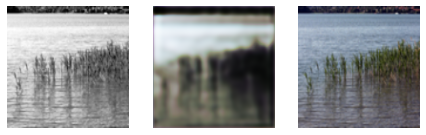

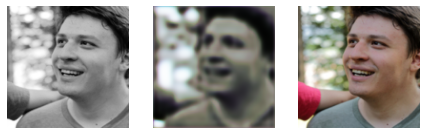

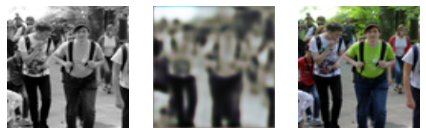

  1%|          | 1/150 [00:14<36:08, 14.55s/it]

0.0767674520611763


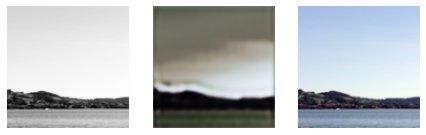

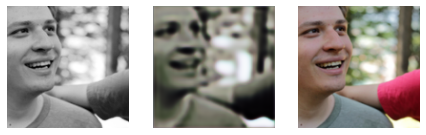

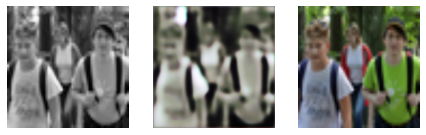

  1%|▏         | 2/150 [00:29<35:53, 14.55s/it]

0.06568842381238937


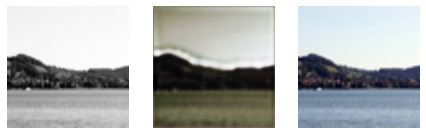

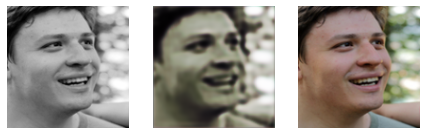

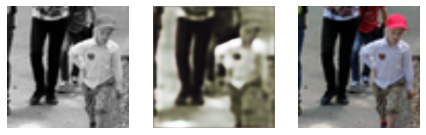

  2%|▏         | 3/150 [00:43<35:47, 14.61s/it]

0.0661030039191246


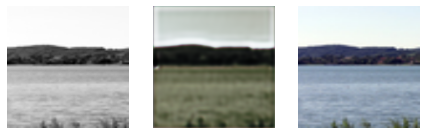

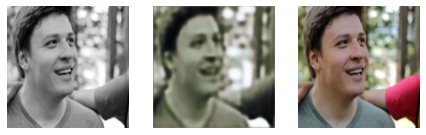

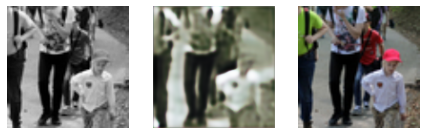

  3%|▎         | 4/150 [00:58<35:28, 14.58s/it]

0.06732355803251266


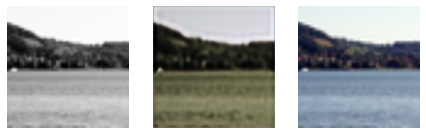

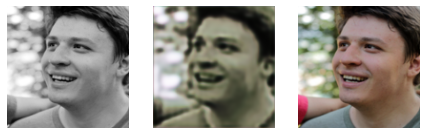

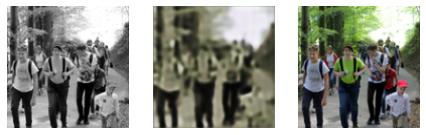

  3%|▎         | 5/150 [01:12<35:08, 14.54s/it]

0.06144386902451515


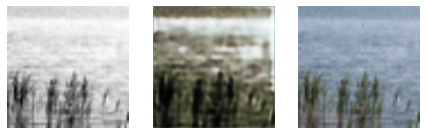

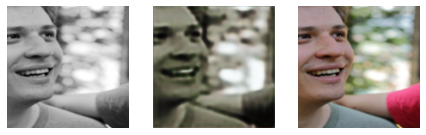

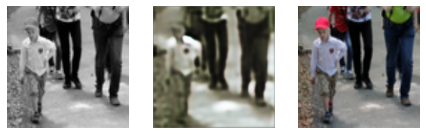

  4%|▍         | 6/150 [01:27<34:59, 14.58s/it]

0.05967050418257713


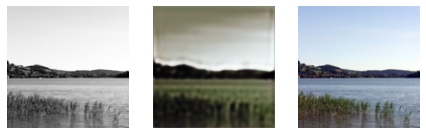

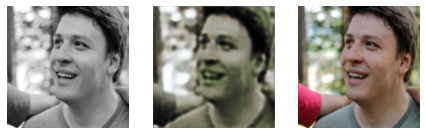

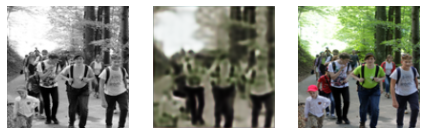

  5%|▍         | 7/150 [01:41<34:39, 14.54s/it]

0.056035738438367844


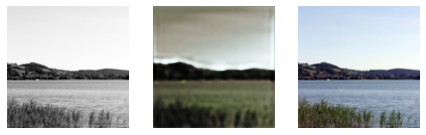

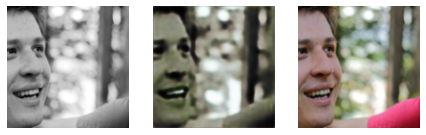

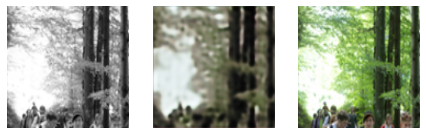

  5%|▌         | 8/150 [01:56<34:26, 14.55s/it]

0.05958032235503197


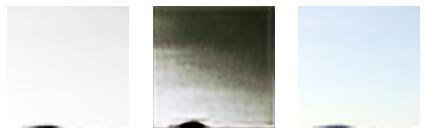

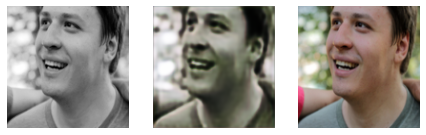

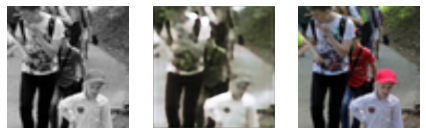

  6%|▌         | 9/150 [02:10<34:08, 14.53s/it]

0.05866747722029686


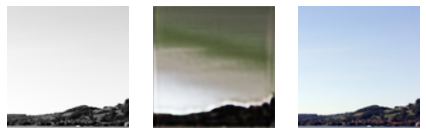

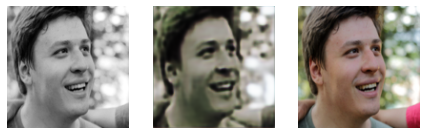

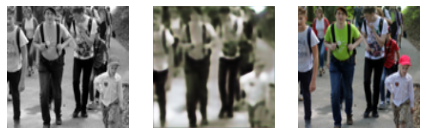

  7%|▋         | 10/150 [02:25<34:00, 14.57s/it]

0.05626881867647171


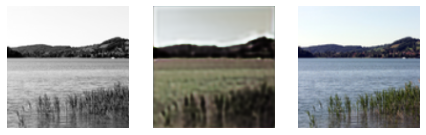

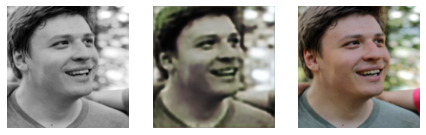

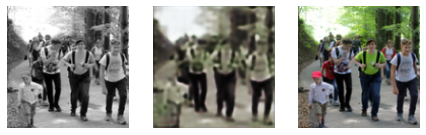

  7%|▋         | 11/150 [02:40<33:42, 14.55s/it]

0.05497109144926071


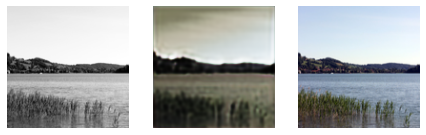

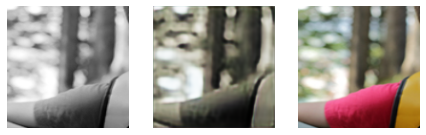

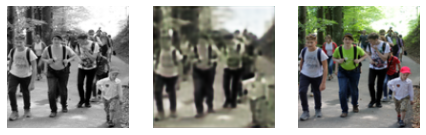

  8%|▊         | 12/150 [02:54<33:29, 14.56s/it]

0.05845233425498009


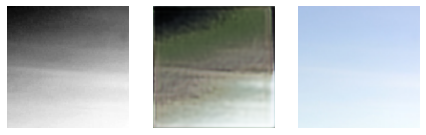

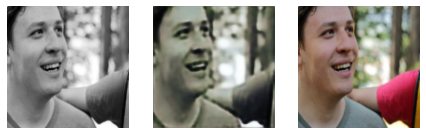

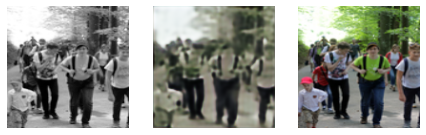

  9%|▊         | 13/150 [03:09<33:16, 14.58s/it]

0.0602869875729084


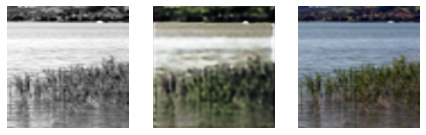

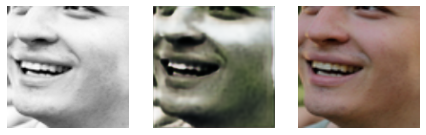

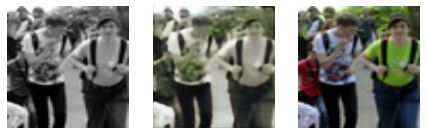

  9%|▉         | 14/150 [03:23<33:02, 14.58s/it]

0.05831610783934593


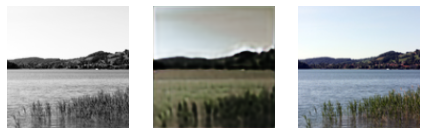

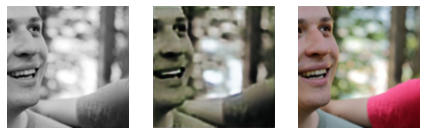

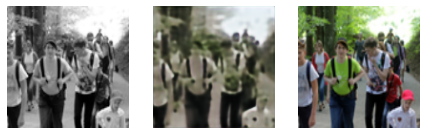

 10%|█         | 15/150 [03:38<32:42, 14.54s/it]

0.05416327342391014


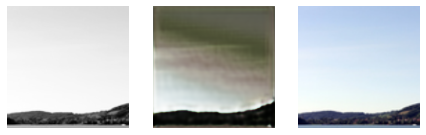

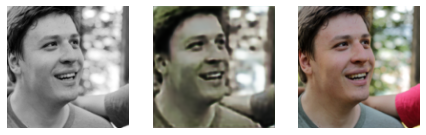

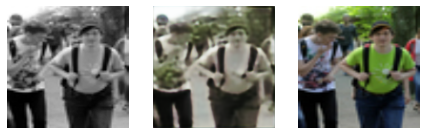

 11%|█         | 16/150 [03:52<32:24, 14.51s/it]

0.053290486335754395


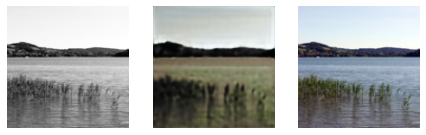

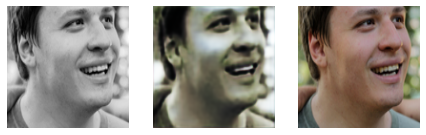

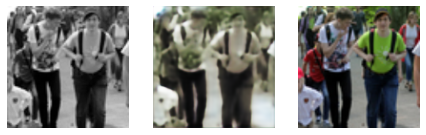

 11%|█▏        | 17/150 [04:07<32:13, 14.54s/it]

0.05558972433209419


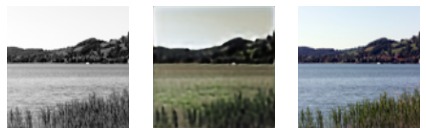

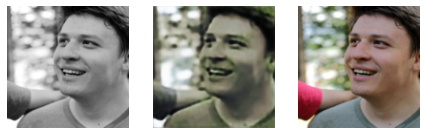

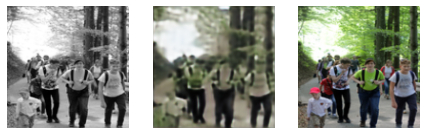

 12%|█▏        | 18/150 [04:22<32:01, 14.56s/it]

0.07068541646003723


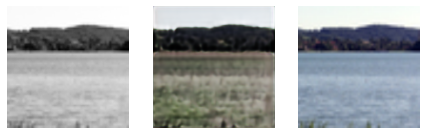

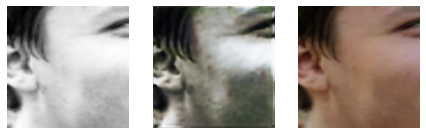

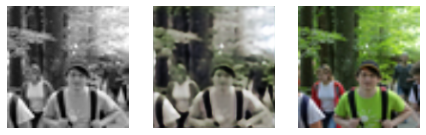

 13%|█▎        | 19/150 [04:36<31:47, 14.56s/it]

0.06023622304201126


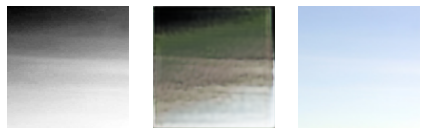

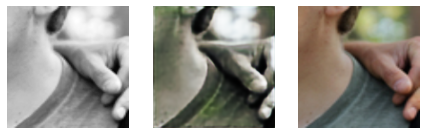

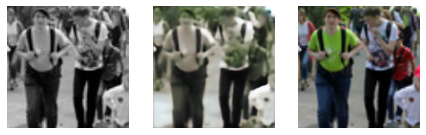

 13%|█▎        | 20/150 [04:51<31:33, 14.57s/it]

0.05173099413514137


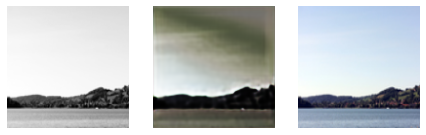

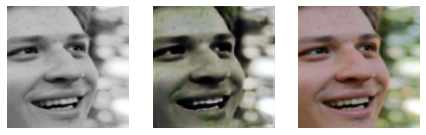

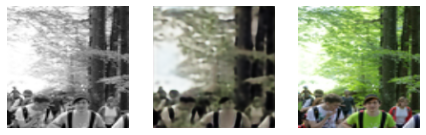

 14%|█▍        | 21/150 [05:05<31:22, 14.59s/it]

0.06635768711566925


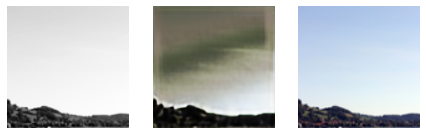

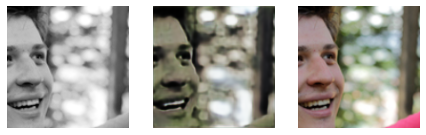

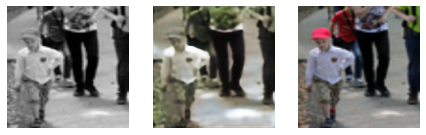

 15%|█▍        | 22/150 [05:20<31:08, 14.59s/it]

0.057697780430316925


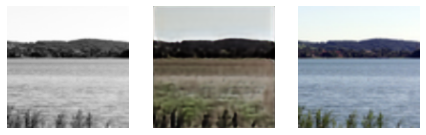

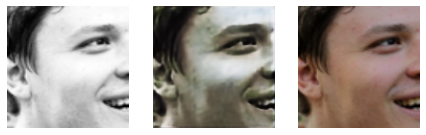

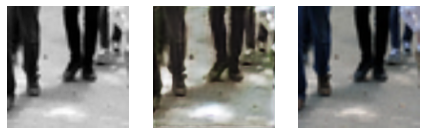

 15%|█▌        | 23/150 [05:34<30:52, 14.59s/it]

0.053838007152080536


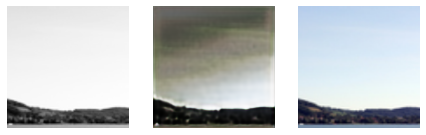

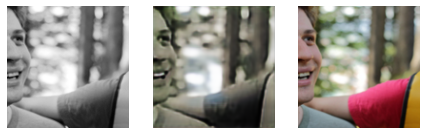

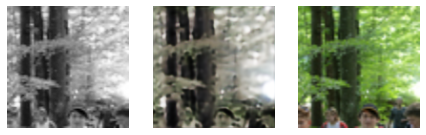

 16%|█▌        | 24/150 [05:49<30:42, 14.62s/it]

0.054789308458566666


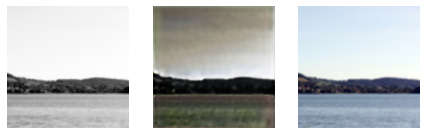

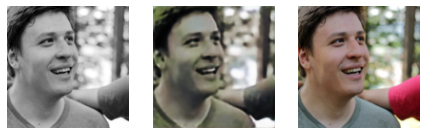

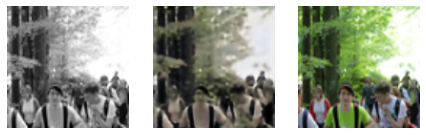

 17%|█▋        | 25/150 [06:04<30:27, 14.62s/it]

0.06167228892445564


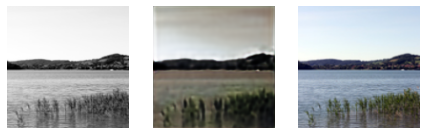

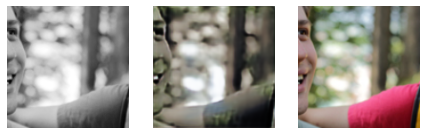

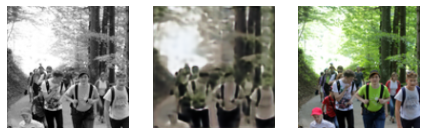

 17%|█▋        | 26/150 [06:18<30:12, 14.62s/it]

0.06669127196073532


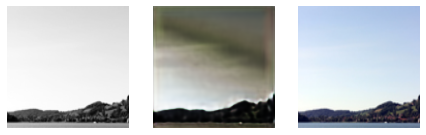

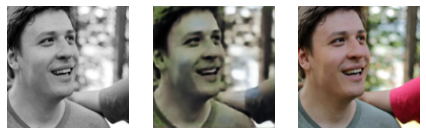

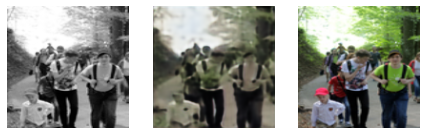

 18%|█▊        | 27/150 [06:33<29:59, 14.63s/it]

0.06519204378128052


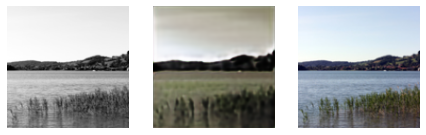

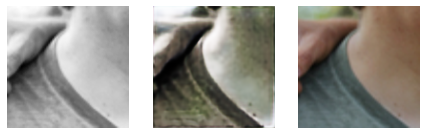

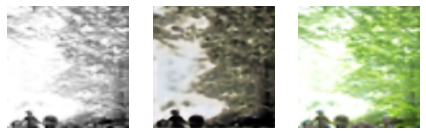

 19%|█▊        | 28/150 [06:48<29:49, 14.67s/it]

0.056703537702560425


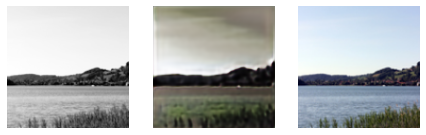

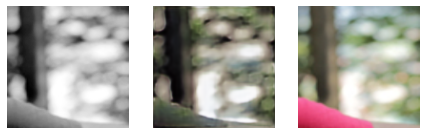

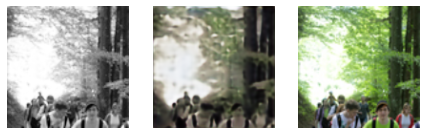

 19%|█▉        | 29/150 [07:02<29:34, 14.66s/it]

0.06443320959806442


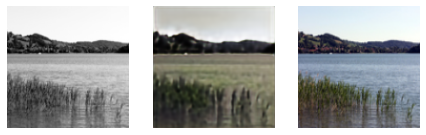

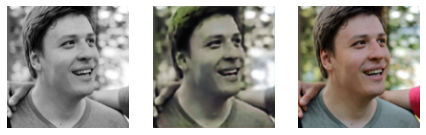

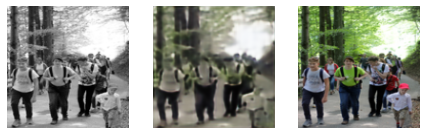

 20%|██        | 30/150 [07:17<29:19, 14.66s/it]

0.05357911437749863


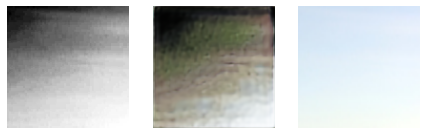

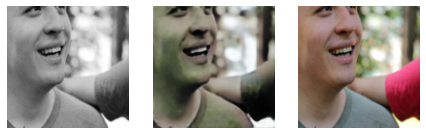

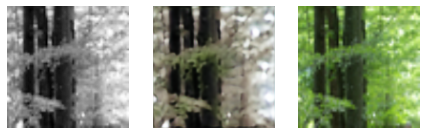

 21%|██        | 31/150 [07:32<29:03, 14.65s/it]

0.061102721840143204


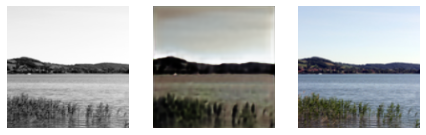

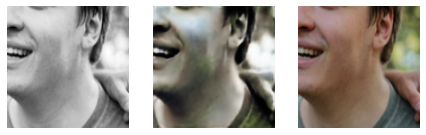

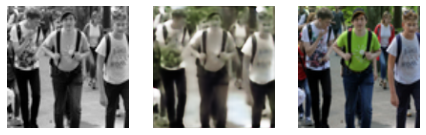

 21%|██▏       | 32/150 [07:46<28:51, 14.68s/it]

0.04709509387612343


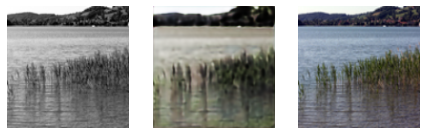

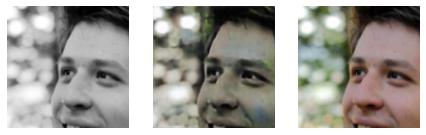

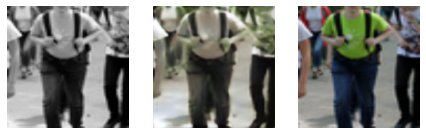

 22%|██▏       | 33/150 [08:01<28:34, 14.66s/it]

0.056035906076431274


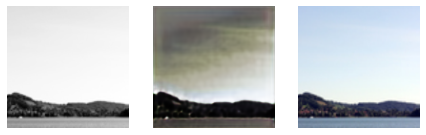

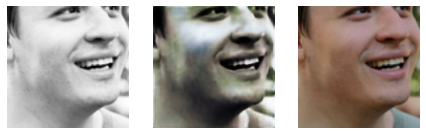

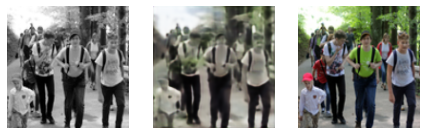

 23%|██▎       | 34/150 [08:16<28:20, 14.66s/it]

0.045952796936035156


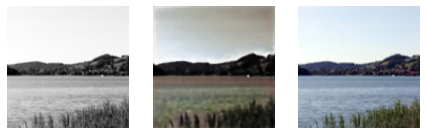

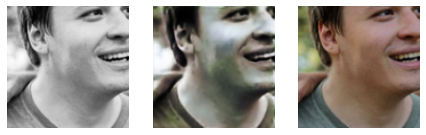

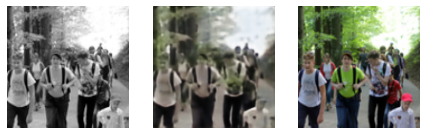

 23%|██▎       | 35/150 [08:30<28:07, 14.67s/it]

0.046641379594802856


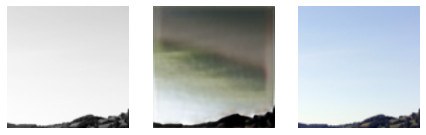

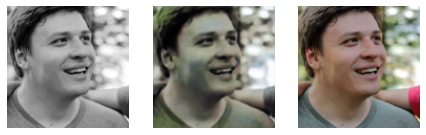

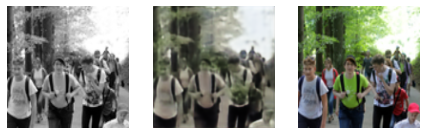

 24%|██▍       | 36/150 [08:45<27:51, 14.66s/it]

0.052250057458877563


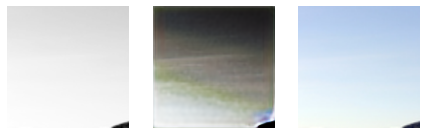

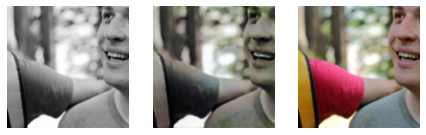

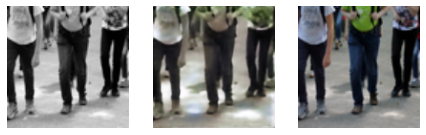

 25%|██▍       | 37/150 [09:00<27:35, 14.65s/it]

0.05651198700070381


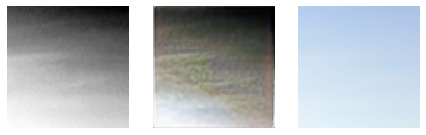

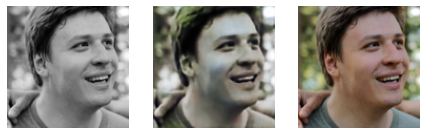

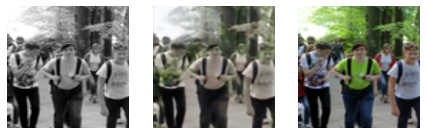

 25%|██▌       | 38/150 [09:14<27:20, 14.65s/it]

0.05292683094739914


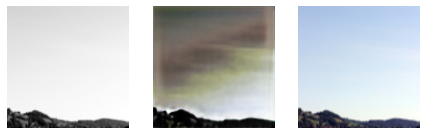

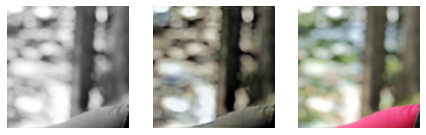

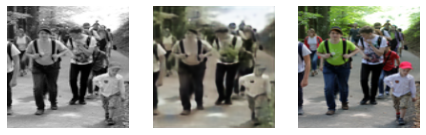

 26%|██▌       | 39/150 [09:29<27:07, 14.67s/it]

0.04829394444823265


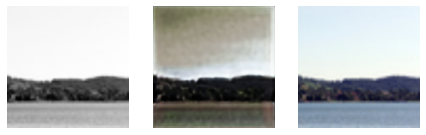

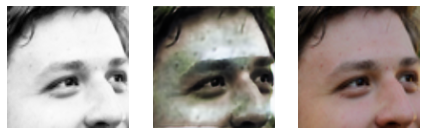

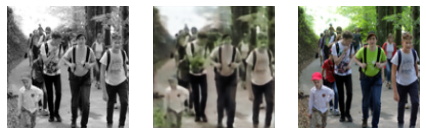

 27%|██▋       | 40/150 [09:44<26:53, 14.67s/it]

0.043203502893447876


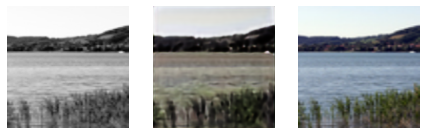

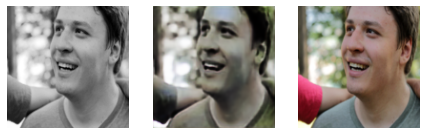

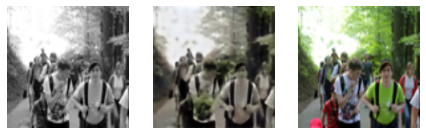

 27%|██▋       | 41/150 [09:58<26:36, 14.65s/it]

0.054674528539180756


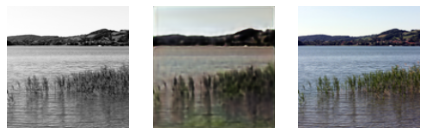

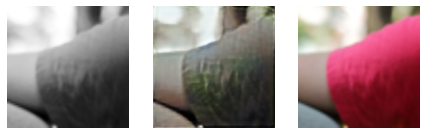

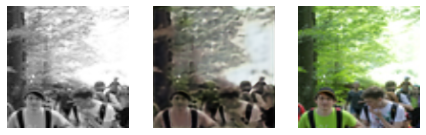

 28%|██▊       | 42/150 [10:13<26:22, 14.65s/it]

0.055504731833934784


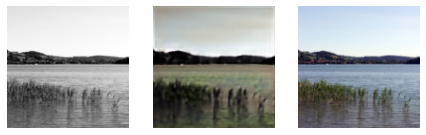

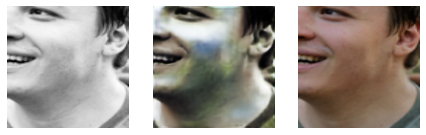

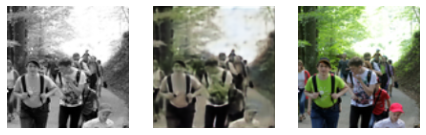

 29%|██▊       | 43/150 [10:28<26:10, 14.67s/it]

0.04705169424414635


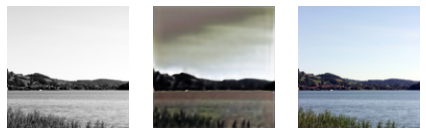

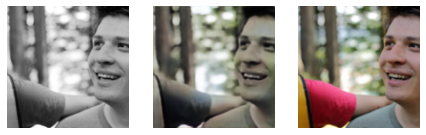

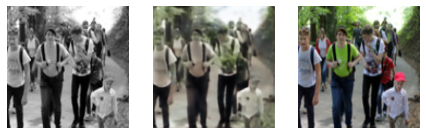

 29%|██▉       | 44/150 [10:42<25:54, 14.67s/it]

0.05095987394452095


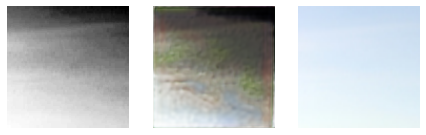

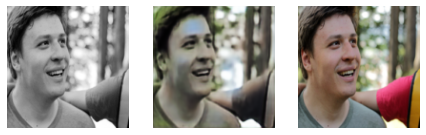

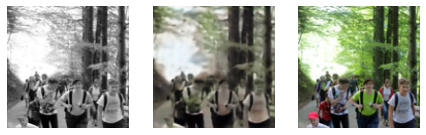

 30%|███       | 45/150 [10:57<25:37, 14.65s/it]

0.047988247126340866


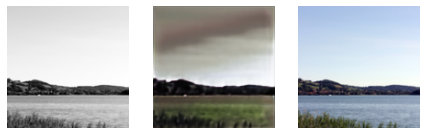

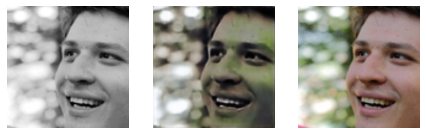

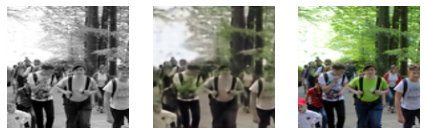

 31%|███       | 46/150 [11:12<25:27, 14.69s/it]

0.061664603650569916


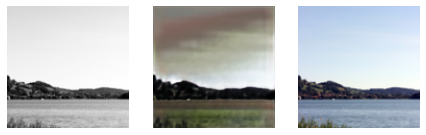

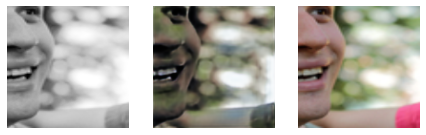

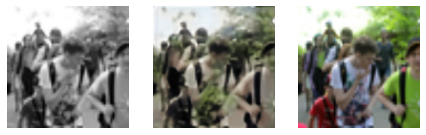

 31%|███▏      | 47/150 [11:26<25:09, 14.66s/it]

0.05527781695127487


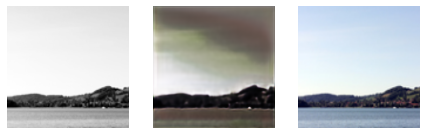

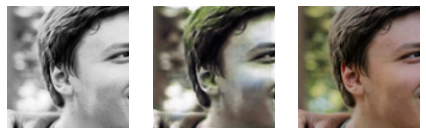

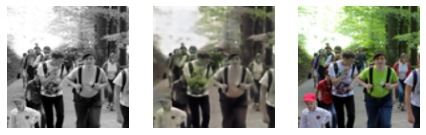

 32%|███▏      | 48/150 [11:41<24:54, 14.66s/it]

0.05043809488415718


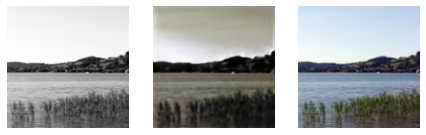

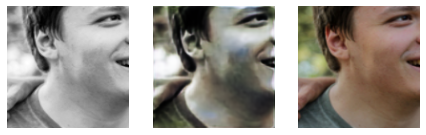

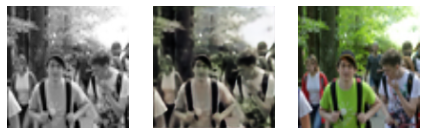

 33%|███▎      | 49/150 [11:56<24:39, 14.65s/it]

0.049606408923864365


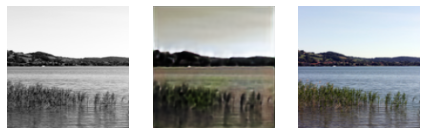

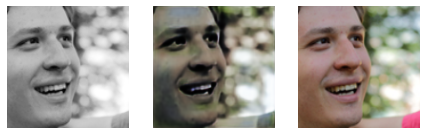

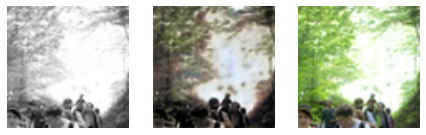

 33%|███▎      | 50/150 [12:10<24:28, 14.69s/it]

0.05297033116221428


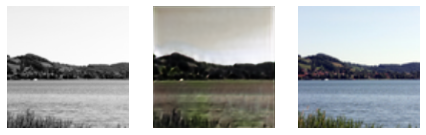

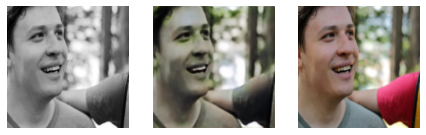

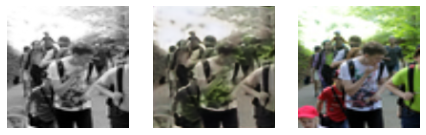

 34%|███▍      | 51/150 [12:25<24:12, 14.67s/it]

0.05559701472520828


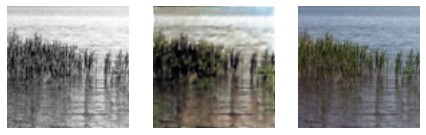

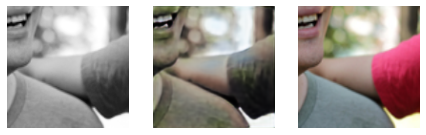

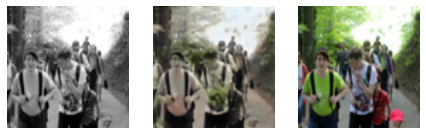

 35%|███▍      | 52/150 [12:40<23:57, 14.67s/it]

0.049479927867650986


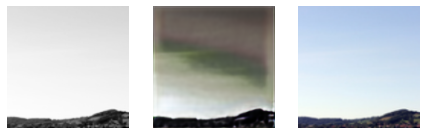

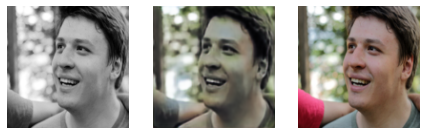

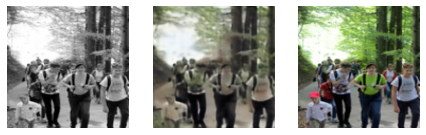

 35%|███▌      | 53/150 [12:54<23:41, 14.66s/it]

0.044494036585092545


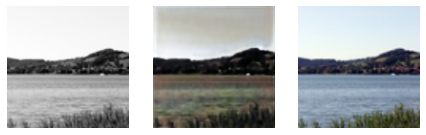

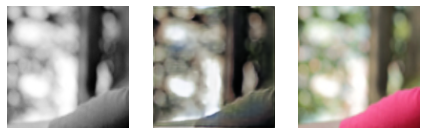

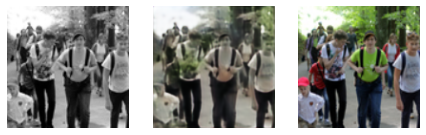

 36%|███▌      | 54/150 [13:09<23:31, 14.70s/it]

0.05472803860902786


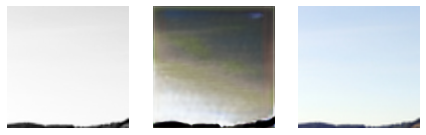

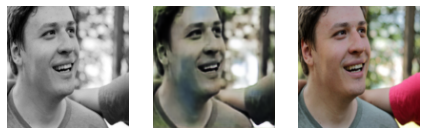

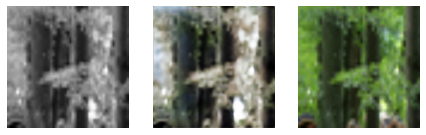

 37%|███▋      | 55/150 [13:24<23:14, 14.68s/it]

0.06161190941929817


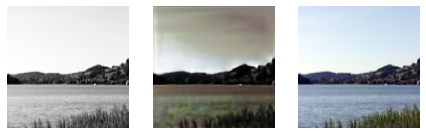

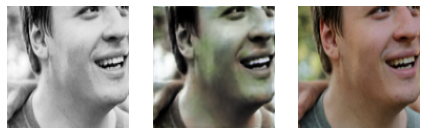

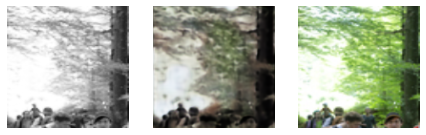

 37%|███▋      | 56/150 [13:38<22:59, 14.68s/it]

0.05067756772041321


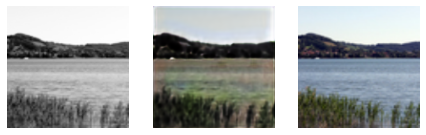

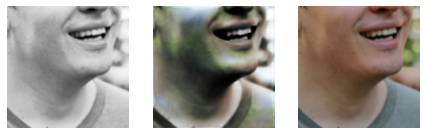

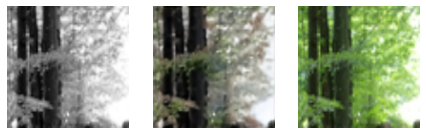

 38%|███▊      | 57/150 [13:53<22:45, 14.69s/it]

0.050221897661685944


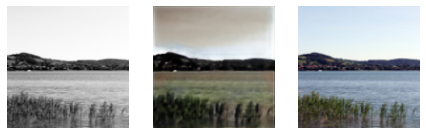

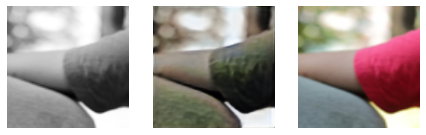

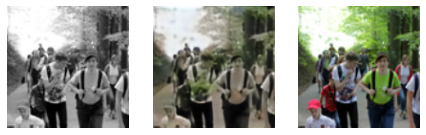

 39%|███▊      | 58/150 [14:08<22:30, 14.68s/it]

0.05669097229838371


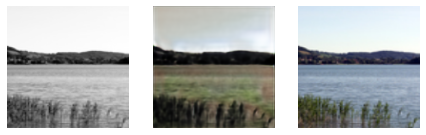

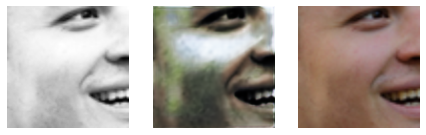

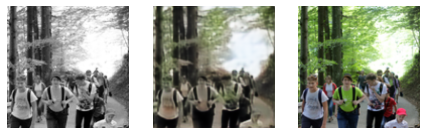

 39%|███▉      | 59/150 [14:22<22:14, 14.66s/it]

0.04723050072789192


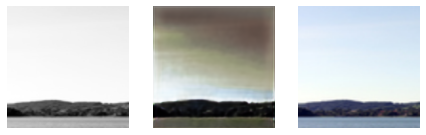

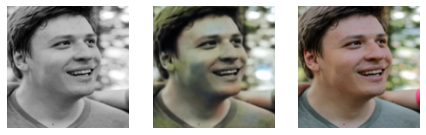

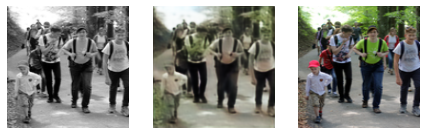

 40%|████      | 60/150 [14:37<21:59, 14.66s/it]

0.05009065940976143


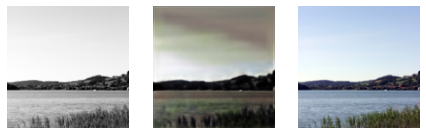

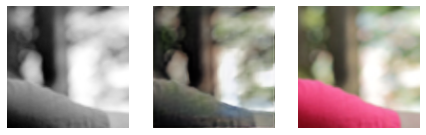

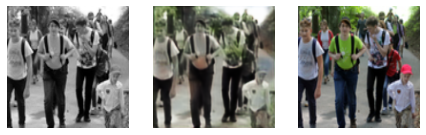

 41%|████      | 61/150 [14:52<21:45, 14.67s/it]

0.05813465639948845


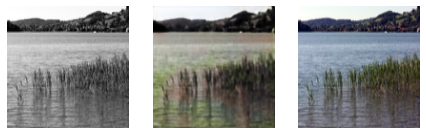

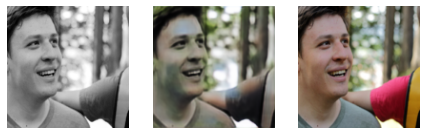

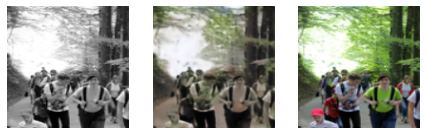

 41%|████▏     | 62/150 [15:06<21:30, 14.67s/it]

0.046761028468608856


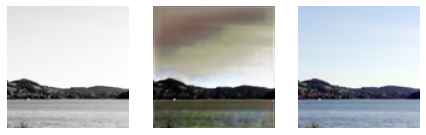

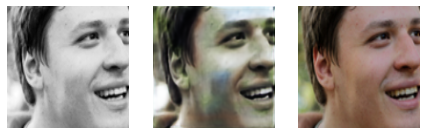

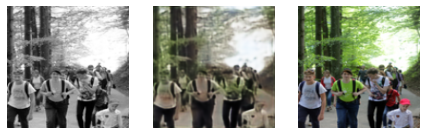

 42%|████▏     | 63/150 [15:21<21:14, 14.65s/it]

0.054575417190790176


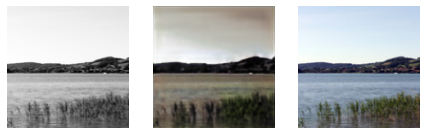

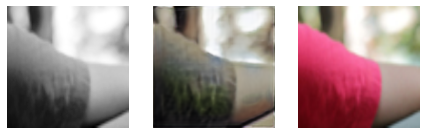

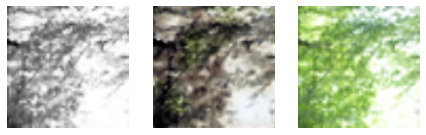

 43%|████▎     | 64/150 [15:36<20:59, 14.65s/it]

0.04803277179598808


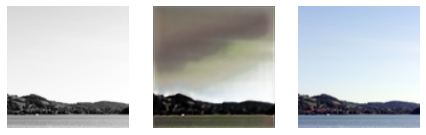

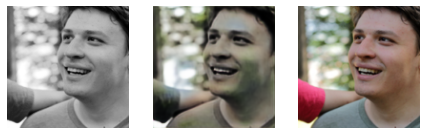

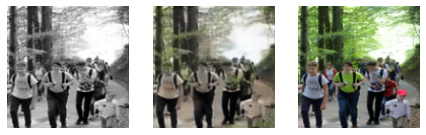

 43%|████▎     | 65/150 [15:50<20:47, 14.67s/it]

0.05587228387594223


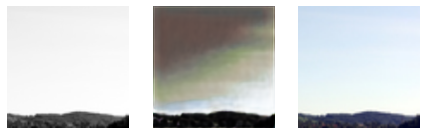

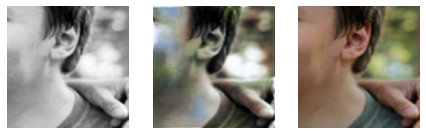

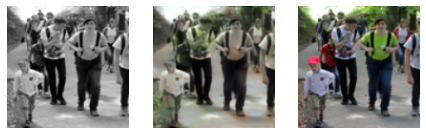

 44%|████▍     | 66/150 [16:05<20:31, 14.66s/it]

0.04630015417933464


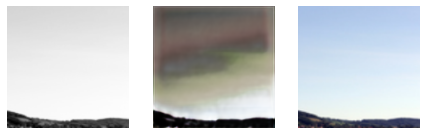

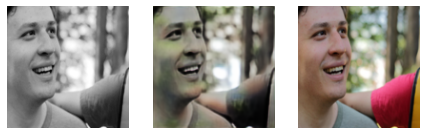

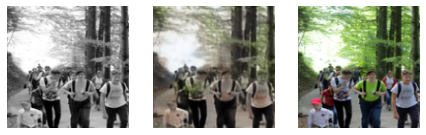

 45%|████▍     | 67/150 [16:20<20:14, 14.64s/it]

0.05620870739221573


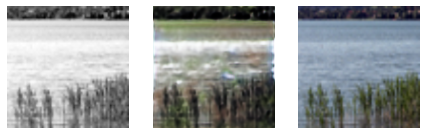

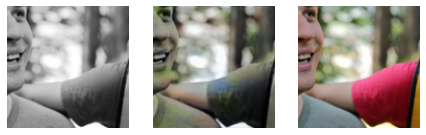

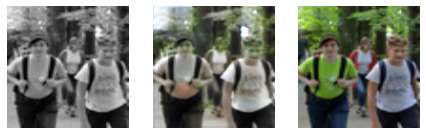

 45%|████▌     | 68/150 [16:34<20:04, 14.69s/it]

0.0449933223426342


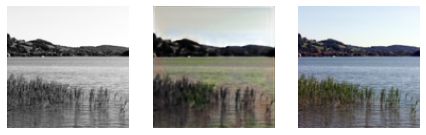

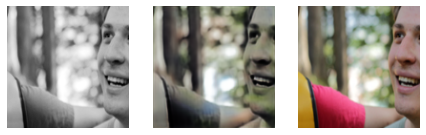

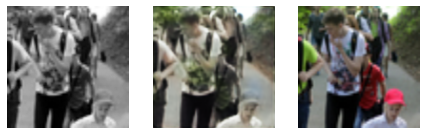

 46%|████▌     | 69/150 [16:49<19:46, 14.65s/it]

0.053577691316604614


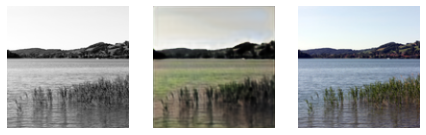

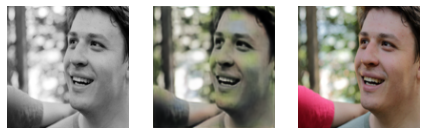

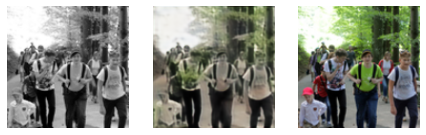

 47%|████▋     | 70/150 [17:04<19:31, 14.64s/it]

0.05696703493595123


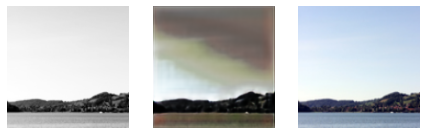

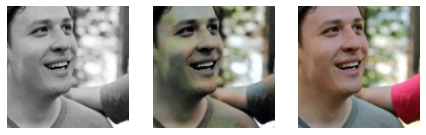

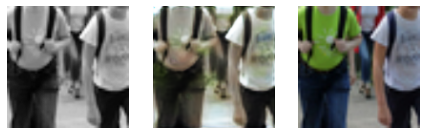

 47%|████▋     | 71/150 [17:18<19:14, 14.61s/it]

0.05155317112803459


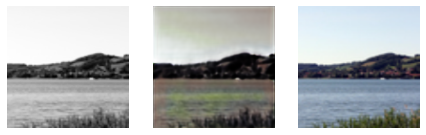

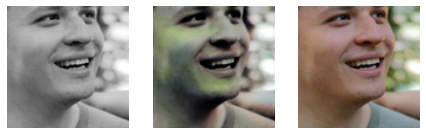

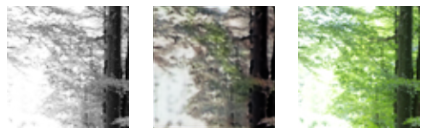

 48%|████▊     | 72/150 [17:33<19:03, 14.65s/it]

0.049170441925525665


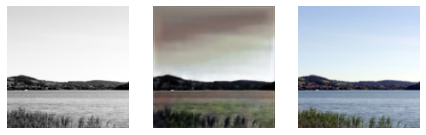

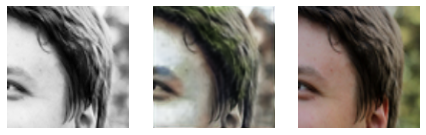

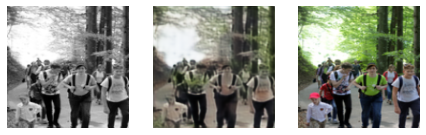

 49%|████▊     | 73/150 [17:48<18:46, 14.63s/it]

0.04628029465675354


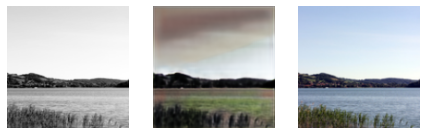

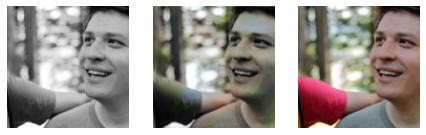

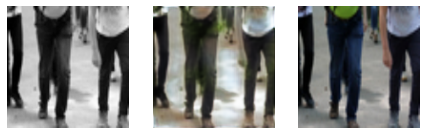

 49%|████▉     | 74/150 [18:02<18:32, 14.63s/it]

0.04556753486394882


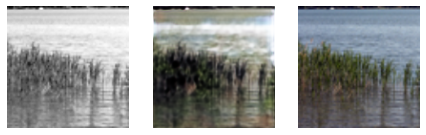

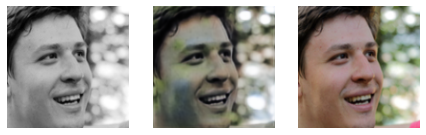

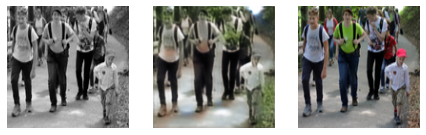

 50%|█████     | 75/150 [18:17<18:16, 14.62s/it]

0.05087258294224739


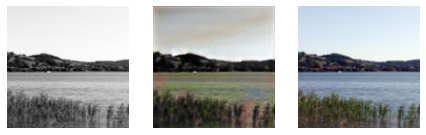

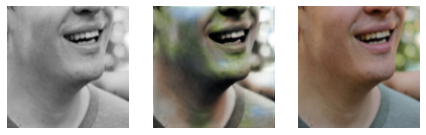

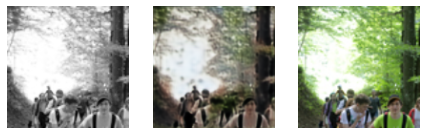

 51%|█████     | 76/150 [18:31<18:03, 14.65s/it]

0.04478470981121063


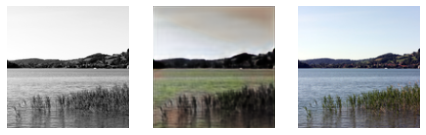

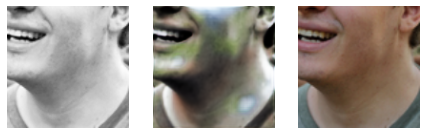

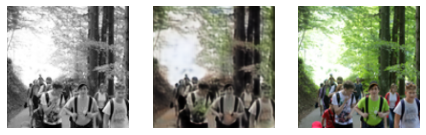

 51%|█████▏    | 77/150 [18:46<17:47, 14.63s/it]

0.04680732265114784


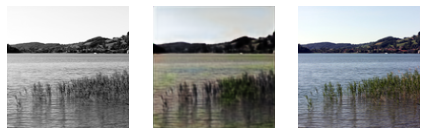

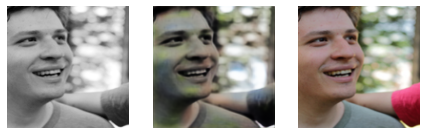

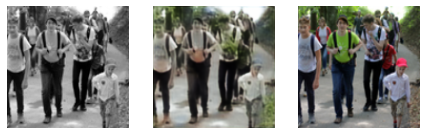

 52%|█████▏    | 78/150 [19:01<17:33, 14.63s/it]

0.04728011414408684


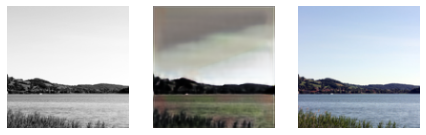

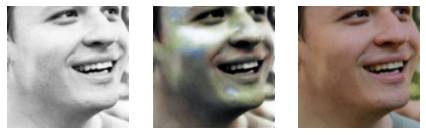

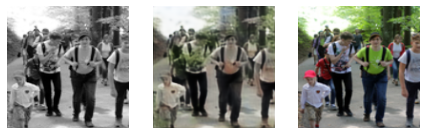

 53%|█████▎    | 79/150 [19:15<17:20, 14.66s/it]

0.04810875654220581


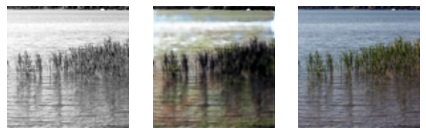

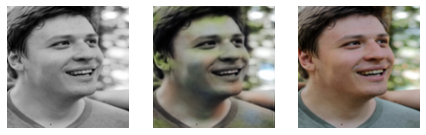

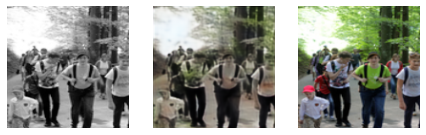

 53%|█████▎    | 80/150 [19:30<17:06, 14.66s/it]

0.044201627373695374


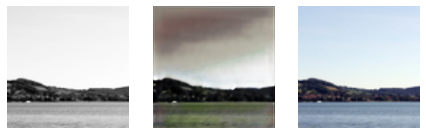

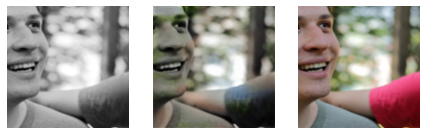

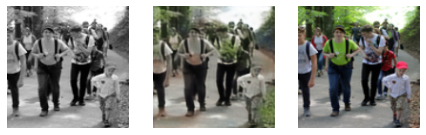

 54%|█████▍    | 81/150 [19:45<16:49, 14.64s/it]

0.04446740448474884


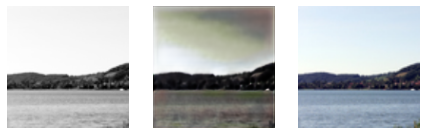

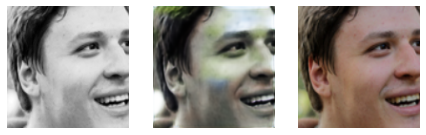

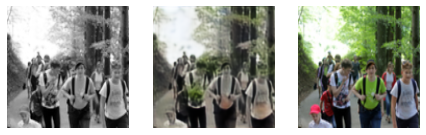

 55%|█████▍    | 82/150 [19:59<16:35, 14.64s/it]

0.05019325390458107


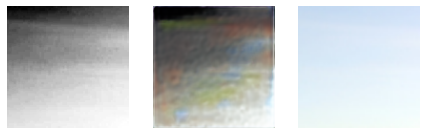

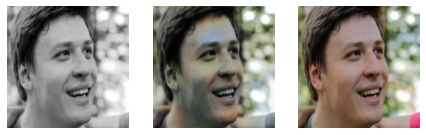

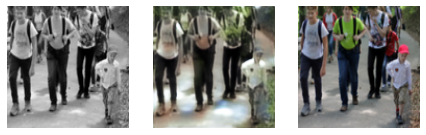

 55%|█████▌    | 83/150 [20:14<16:21, 14.64s/it]

0.04232136160135269


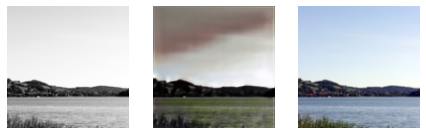

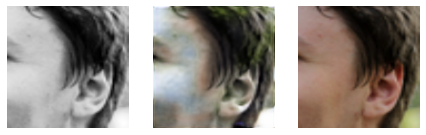

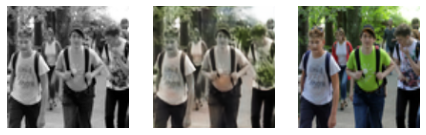

 56%|█████▌    | 84/150 [20:29<16:05, 14.63s/it]

0.04502519592642784


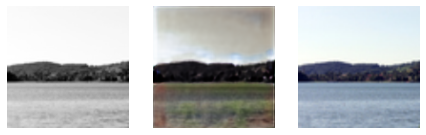

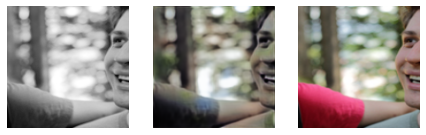

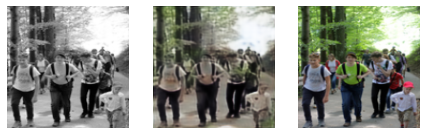

 57%|█████▋    | 85/150 [20:43<15:49, 14.61s/it]

0.038975898176431656


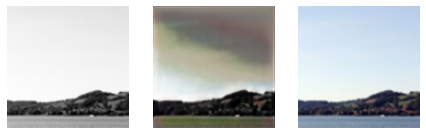

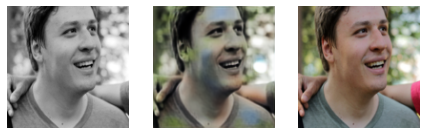

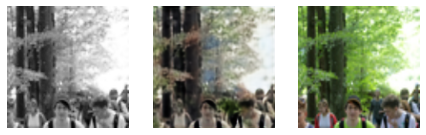

 57%|█████▋    | 86/150 [20:58<15:35, 14.61s/it]

0.05129043385386467


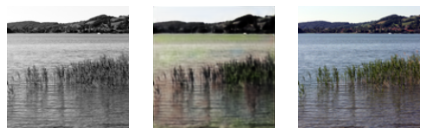

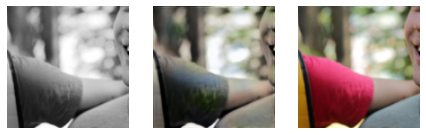

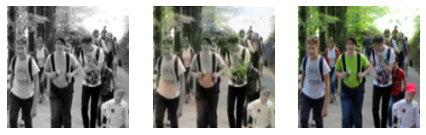

 58%|█████▊    | 87/150 [21:12<15:22, 14.64s/it]

0.05008756369352341


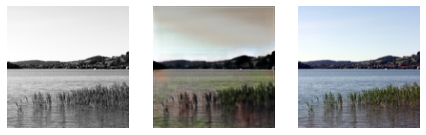

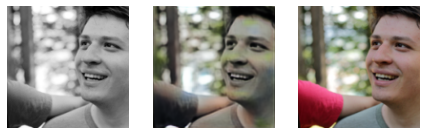

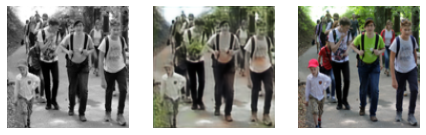

 59%|█████▊    | 88/150 [21:27<15:07, 14.63s/it]

0.0462692491710186


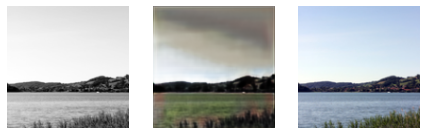

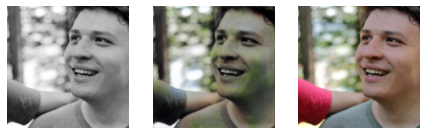

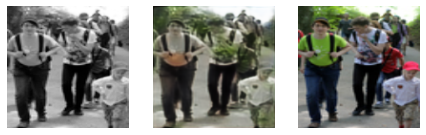

 59%|█████▉    | 89/150 [21:42<14:51, 14.62s/it]

0.04347405582666397


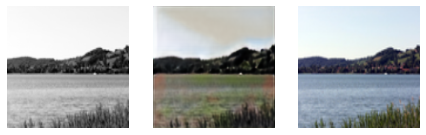

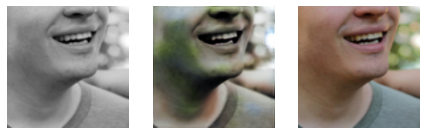

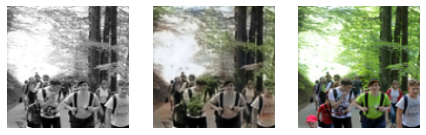

 60%|██████    | 90/150 [21:56<14:38, 14.64s/it]

0.04795728623867035


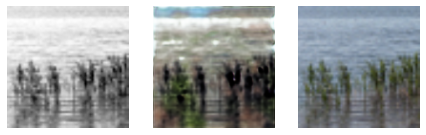

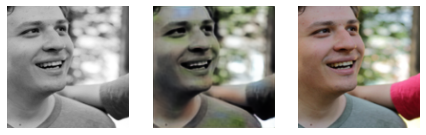

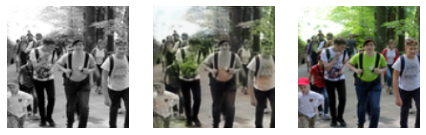

 61%|██████    | 91/150 [22:11<14:22, 14.61s/it]

0.047098077833652496


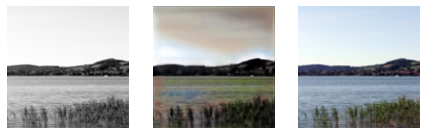

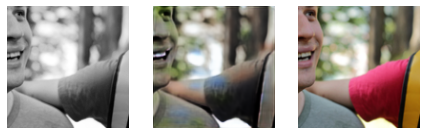

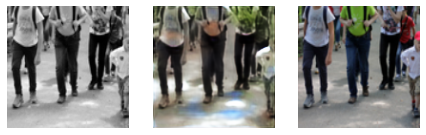

 61%|██████▏   | 92/150 [22:26<14:07, 14.61s/it]

0.04426027089357376


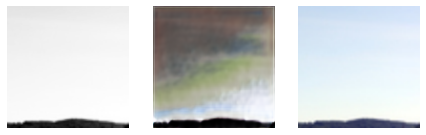

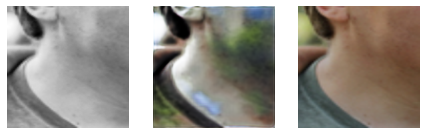

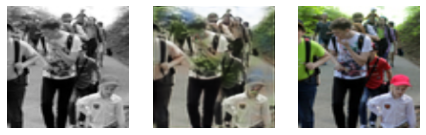

 62%|██████▏   | 93/150 [22:40<13:51, 14.60s/it]

0.04715370386838913


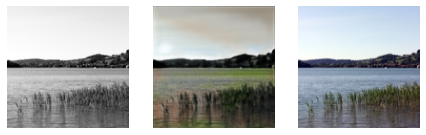

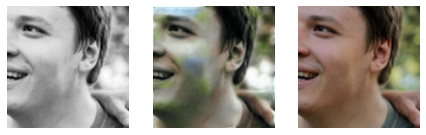

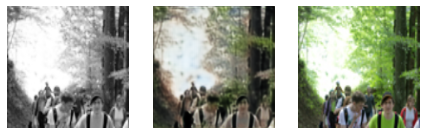

 63%|██████▎   | 94/150 [22:55<13:39, 14.64s/it]

0.0508883036673069


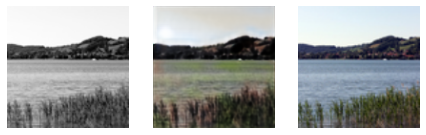

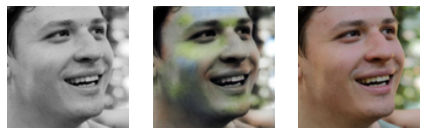

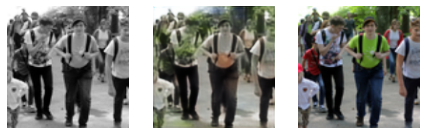

 63%|██████▎   | 95/150 [23:09<13:23, 14.62s/it]

0.045047879219055176


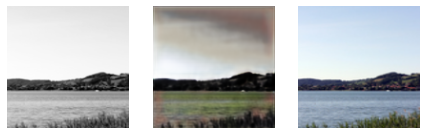

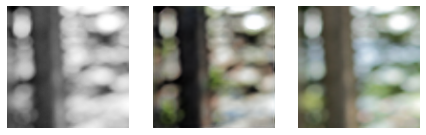

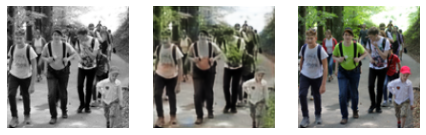

 64%|██████▍   | 96/150 [23:24<13:09, 14.62s/it]

0.044157836586236954


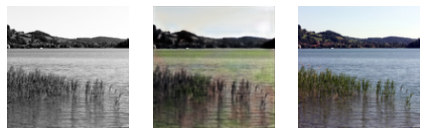

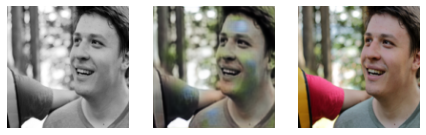

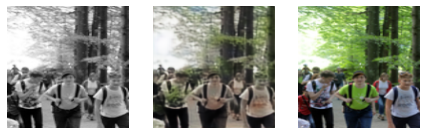

 65%|██████▍   | 97/150 [23:39<12:54, 14.61s/it]

0.05392635241150856


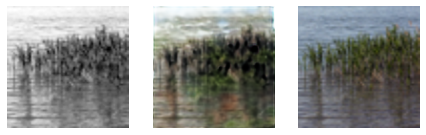

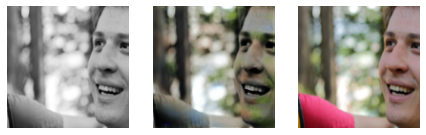

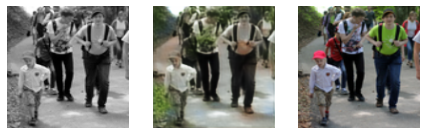

 65%|██████▌   | 98/150 [23:53<12:42, 14.66s/it]

0.045448388904333115


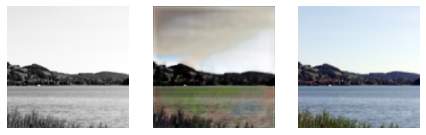

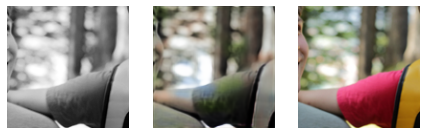

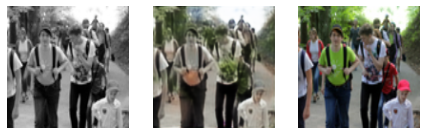

 66%|██████▌   | 99/150 [24:08<12:26, 14.64s/it]

0.04979008436203003


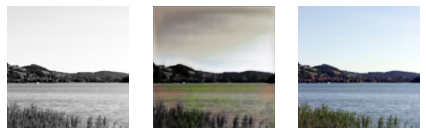

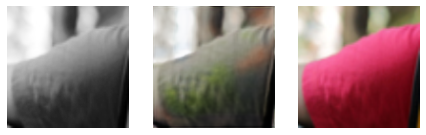

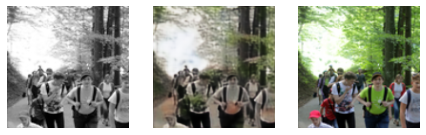

 67%|██████▋   | 100/150 [24:23<12:11, 14.64s/it]

0.04421570524573326


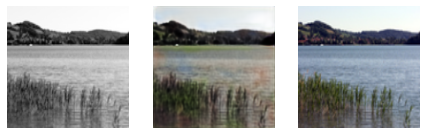

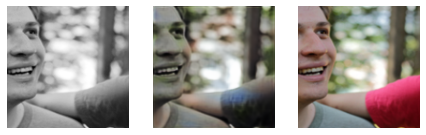

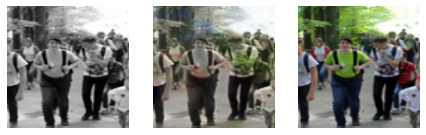

 67%|██████▋   | 101/150 [24:37<11:58, 14.66s/it]

0.04328083619475365


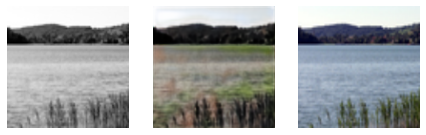

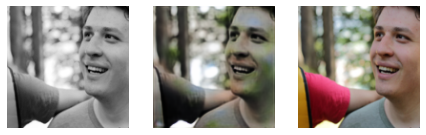

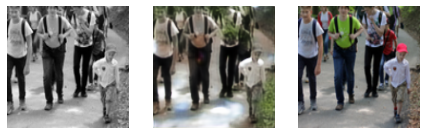

 68%|██████▊   | 102/150 [24:52<11:43, 14.65s/it]

0.04327784478664398


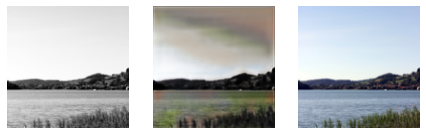

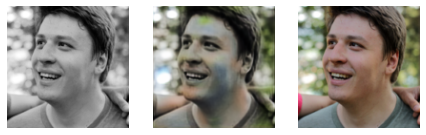

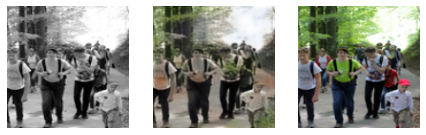

 69%|██████▊   | 103/150 [25:06<11:27, 14.62s/it]

0.05935794860124588


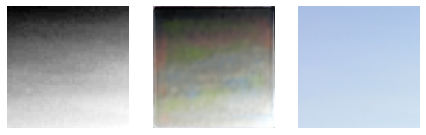

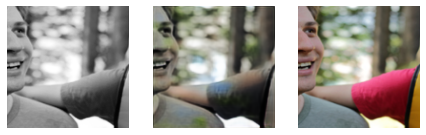

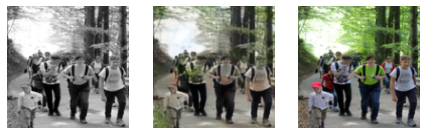

 69%|██████▉   | 104/150 [25:21<11:12, 14.62s/it]

0.04409855604171753


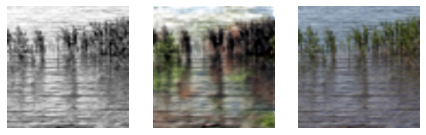

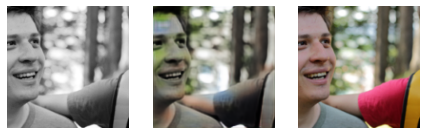

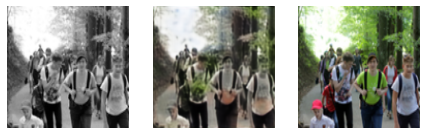

 70%|███████   | 105/150 [25:36<10:59, 14.65s/it]

0.04807020723819733


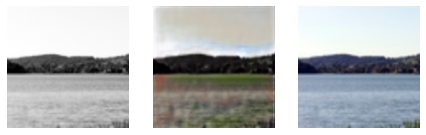

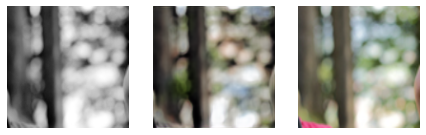

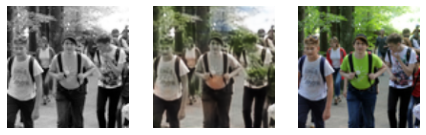

 71%|███████   | 106/150 [25:50<10:44, 14.64s/it]

0.04822526127099991


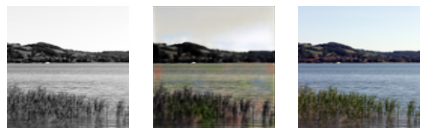

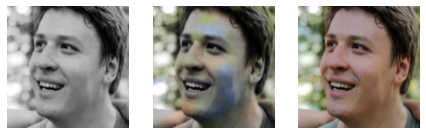

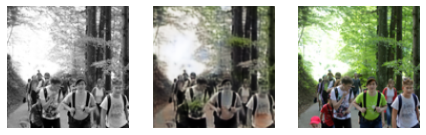

 71%|███████▏  | 107/150 [26:05<10:28, 14.62s/it]

0.04974249377846718


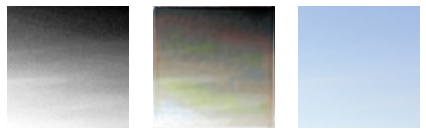

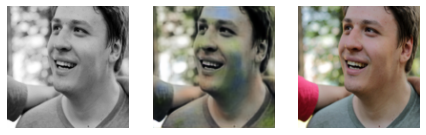

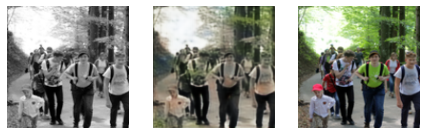

 72%|███████▏  | 108/150 [26:20<10:14, 14.63s/it]

0.041519731283187866


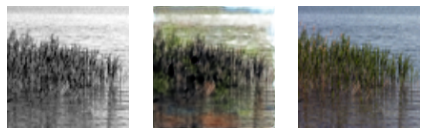

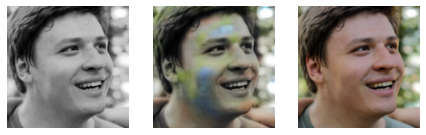

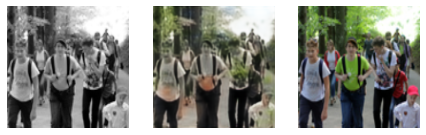

 73%|███████▎  | 109/150 [26:34<10:00, 14.65s/it]

0.04393956437706947


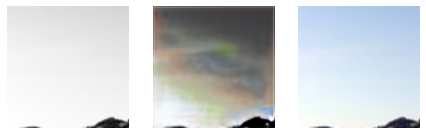

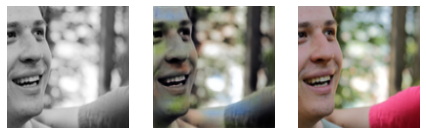

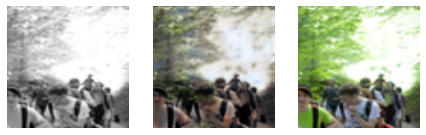

 73%|███████▎  | 110/150 [26:49<09:45, 14.64s/it]

0.04576787352561951


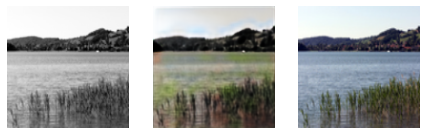

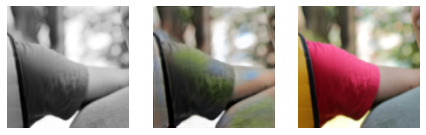

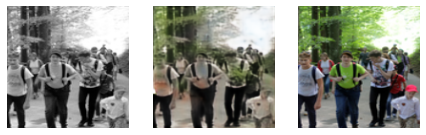

 74%|███████▍  | 111/150 [27:04<09:30, 14.62s/it]

0.051968302577733994


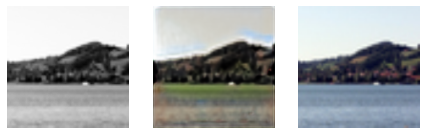

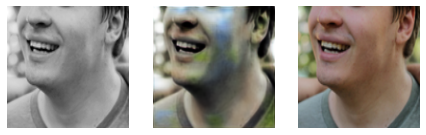

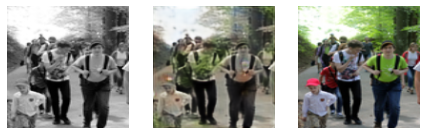

 75%|███████▍  | 112/150 [27:18<09:16, 14.65s/it]

0.046205636113882065


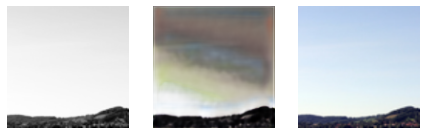

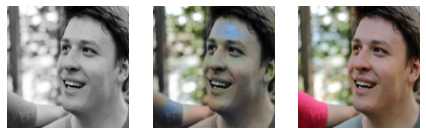

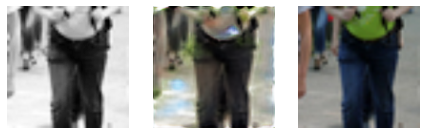

 75%|███████▌  | 113/150 [27:33<09:01, 14.62s/it]

0.041093531996011734


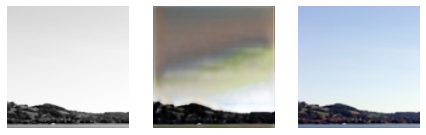

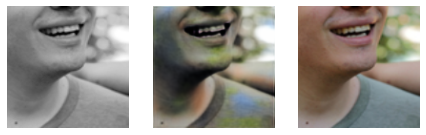

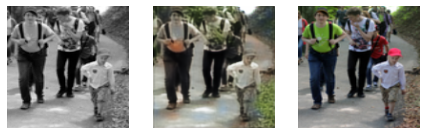

 76%|███████▌  | 114/150 [27:47<08:46, 14.61s/it]

0.04576298967003822


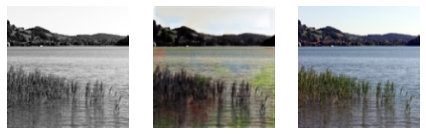

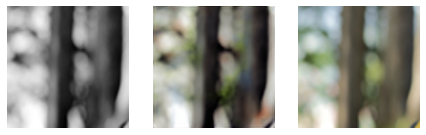

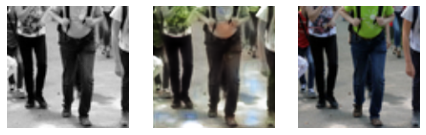

 77%|███████▋  | 115/150 [28:02<08:30, 14.60s/it]

0.04603409022092819


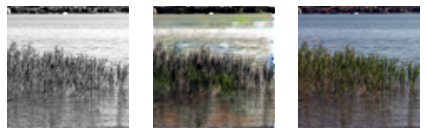

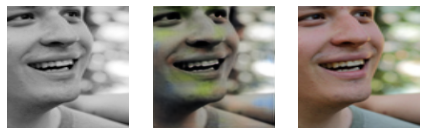

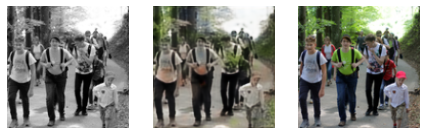

 77%|███████▋  | 116/150 [28:17<08:18, 14.65s/it]

0.047123853117227554


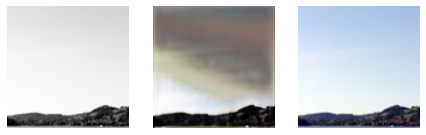

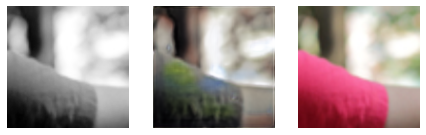

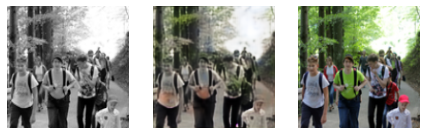

 78%|███████▊  | 117/150 [28:31<08:03, 14.65s/it]

0.04426492378115654


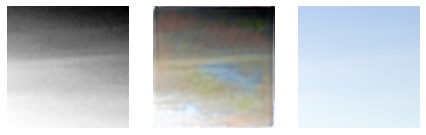

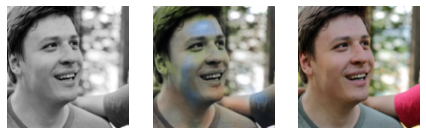

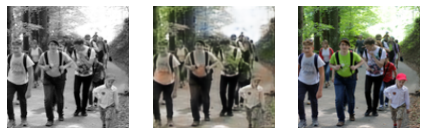

 79%|███████▊  | 118/150 [28:46<07:48, 14.65s/it]

0.06221145763993263


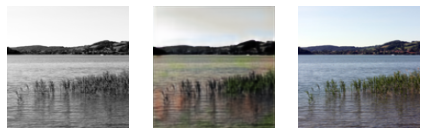

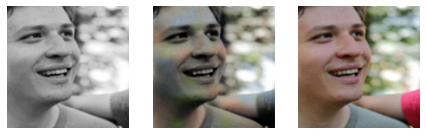

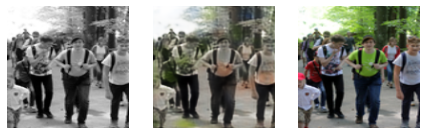

 79%|███████▉  | 119/150 [29:01<07:33, 14.63s/it]

0.0542750246822834


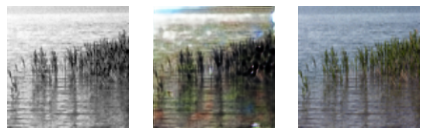

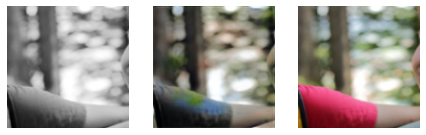

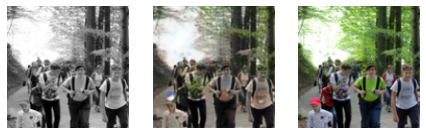

 80%|████████  | 120/150 [29:15<07:20, 14.68s/it]

0.044486064463853836


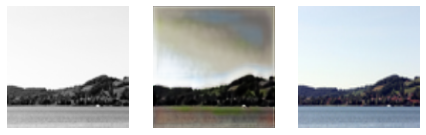

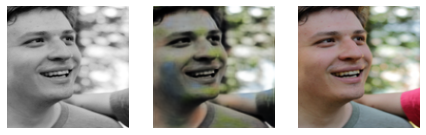

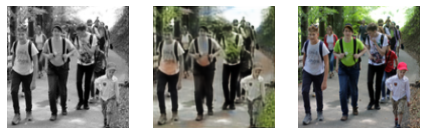

 81%|████████  | 121/150 [29:30<07:05, 14.66s/it]

0.04789403825998306


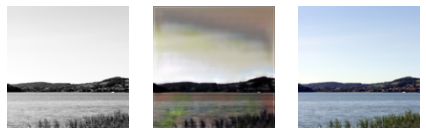

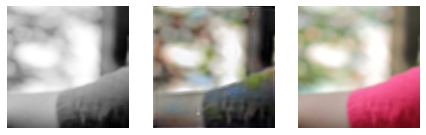

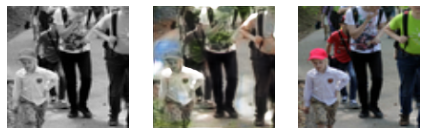

 81%|████████▏ | 122/150 [29:45<06:50, 14.67s/it]

0.05003487318754196


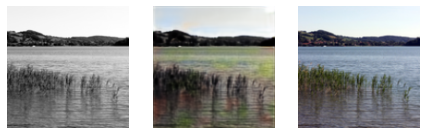

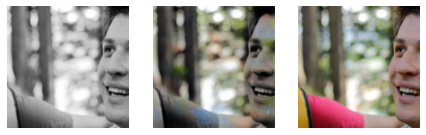

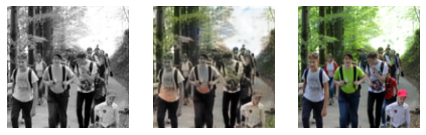

 82%|████████▏ | 123/150 [29:59<06:36, 14.68s/it]

0.05441393703222275


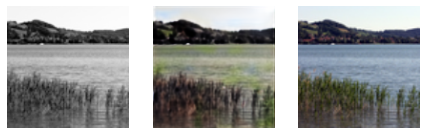

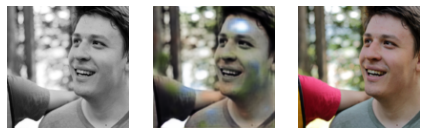

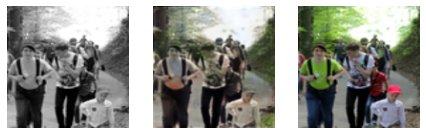

 83%|████████▎ | 124/150 [30:14<06:21, 14.69s/it]

0.05147070437669754


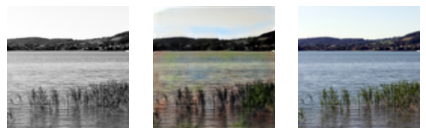

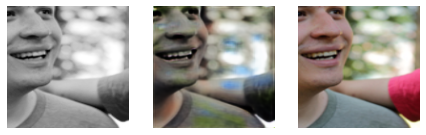

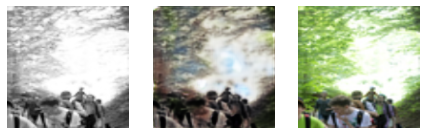

 83%|████████▎ | 125/150 [30:29<06:07, 14.69s/it]

0.04961102828383446


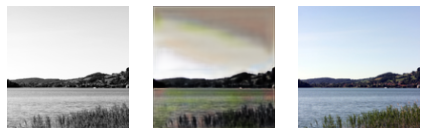

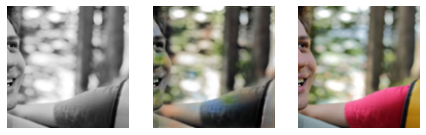

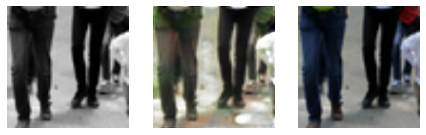

 84%|████████▍ | 126/150 [30:44<05:52, 14.68s/it]

0.04507927969098091


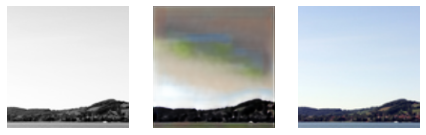

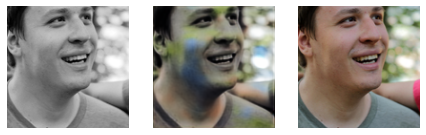

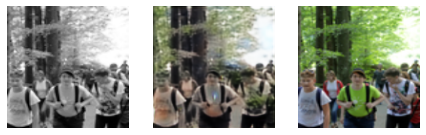

 85%|████████▍ | 127/150 [30:58<05:37, 14.69s/it]

0.04200691729784012


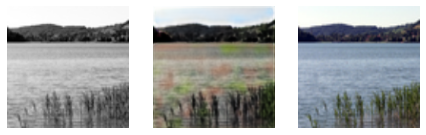

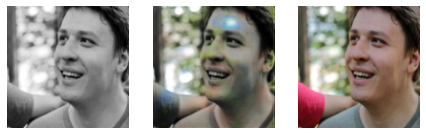

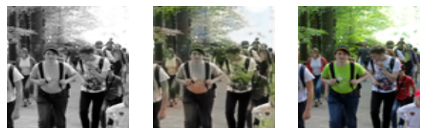

 85%|████████▌ | 128/150 [31:13<05:23, 14.69s/it]

0.056225456297397614


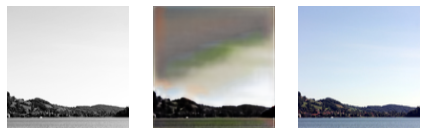

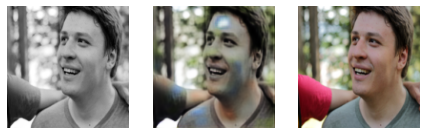

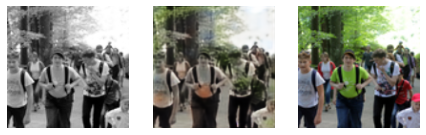

 86%|████████▌ | 129/150 [31:27<05:07, 14.66s/it]

0.049936529248952866


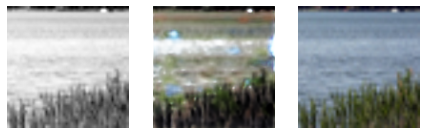

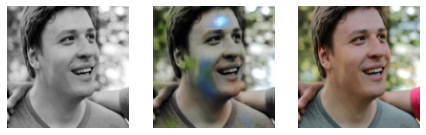

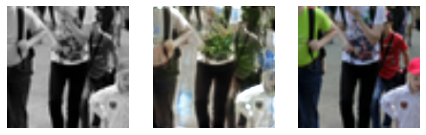

 87%|████████▋ | 130/150 [31:42<04:53, 14.67s/it]

0.043996889144182205


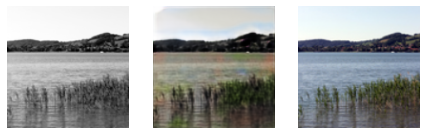

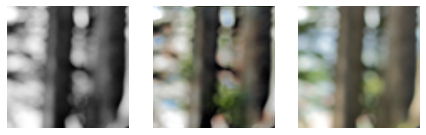

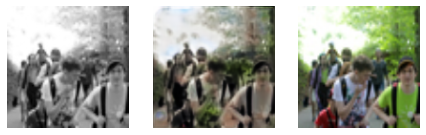

 87%|████████▋ | 131/150 [31:57<04:38, 14.68s/it]

0.0469166561961174


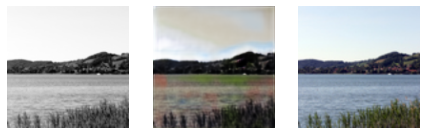

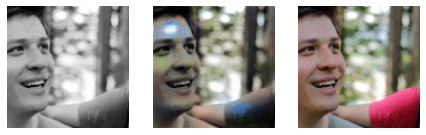

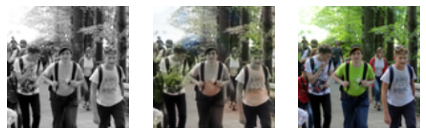

 88%|████████▊ | 132/150 [32:12<04:24, 14.70s/it]

0.04872455447912216


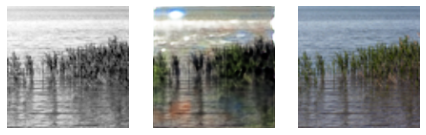

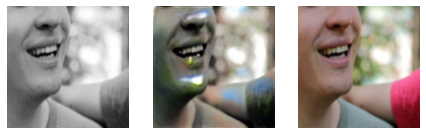

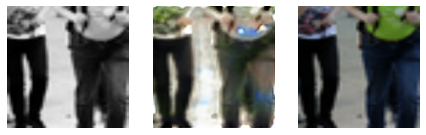

 89%|████████▊ | 133/150 [32:26<04:09, 14.67s/it]

0.04347997531294823


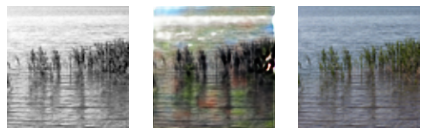

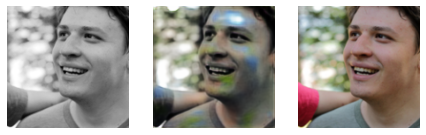

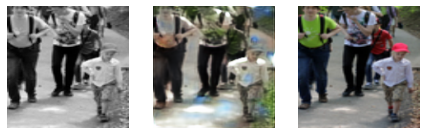

 89%|████████▉ | 134/150 [32:41<03:55, 14.70s/it]

0.04274148866534233


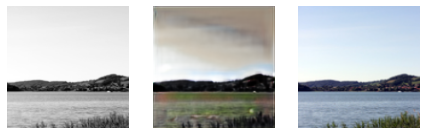

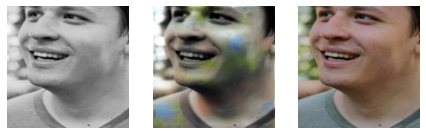

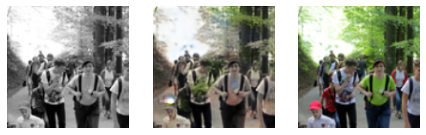

 90%|█████████ | 135/150 [32:56<03:40, 14.69s/it]

0.04293857887387276


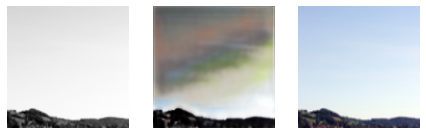

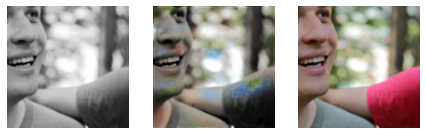

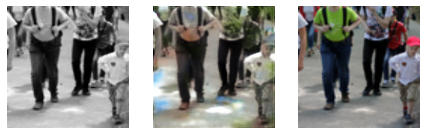

 91%|█████████ | 136/150 [33:10<03:25, 14.69s/it]

0.04349528253078461


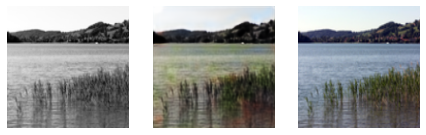

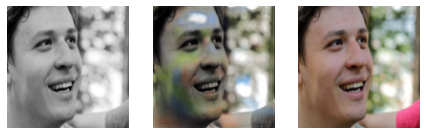

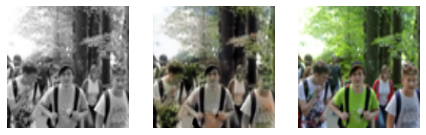

 91%|█████████▏| 137/150 [33:25<03:10, 14.67s/it]

0.04697869345545769


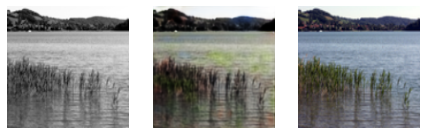

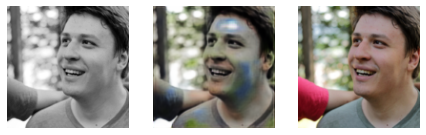

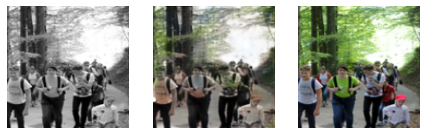

 92%|█████████▏| 138/150 [33:40<02:56, 14.71s/it]

0.040719904005527496


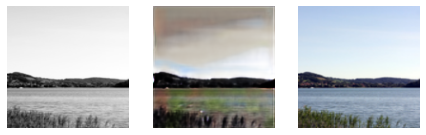

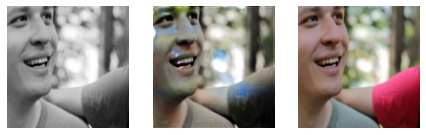

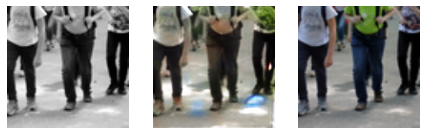

 93%|█████████▎| 139/150 [33:54<02:41, 14.69s/it]

0.04062151163816452


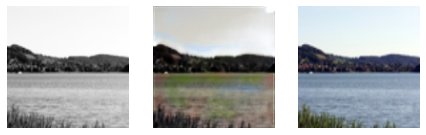

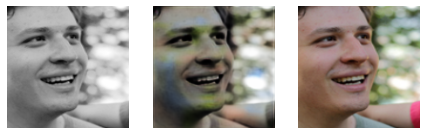

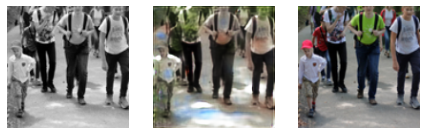

 93%|█████████▎| 140/150 [34:09<02:26, 14.69s/it]

0.04575232416391373


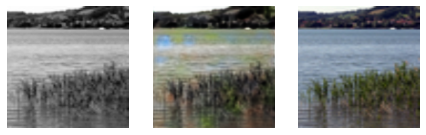

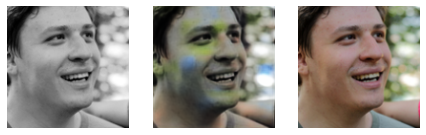

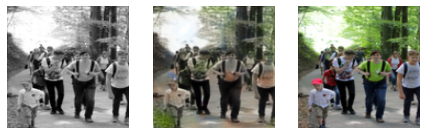

 94%|█████████▍| 141/150 [34:24<02:12, 14.68s/it]

0.04095204547047615


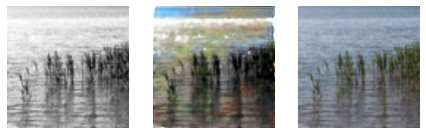

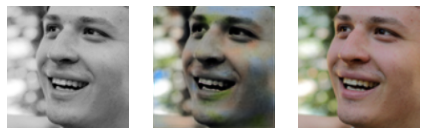

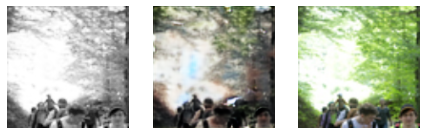

 95%|█████████▍| 142/150 [34:39<01:57, 14.72s/it]

0.046519599854946136


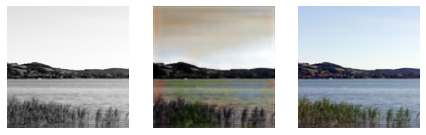

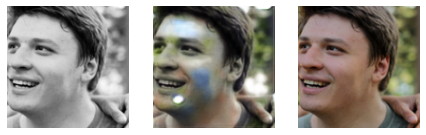

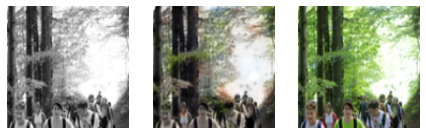

 95%|█████████▌| 143/150 [34:53<01:42, 14.70s/it]

0.04452195018529892


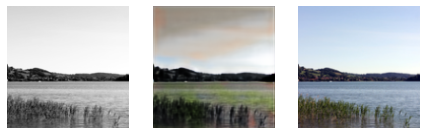

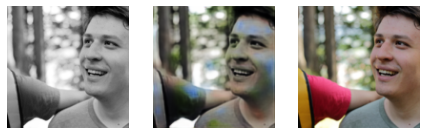

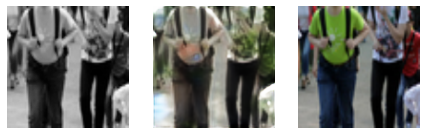

 96%|█████████▌| 144/150 [35:08<01:28, 14.69s/it]

0.046110574156045914


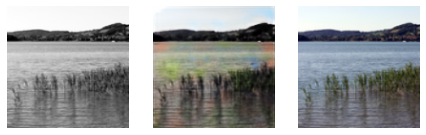

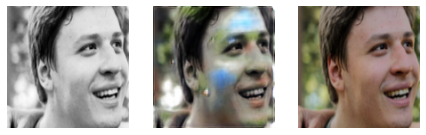

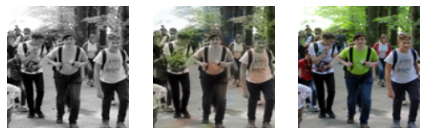

 97%|█████████▋| 145/150 [35:23<01:13, 14.70s/it]

0.0514855682849884


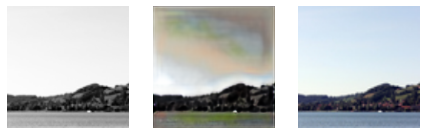

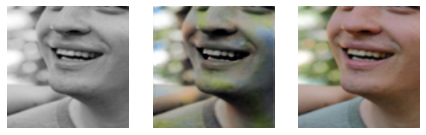

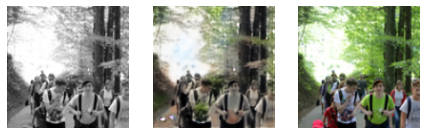

 97%|█████████▋| 146/150 [35:37<00:58, 14.69s/it]

0.04254280775785446


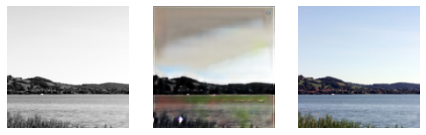

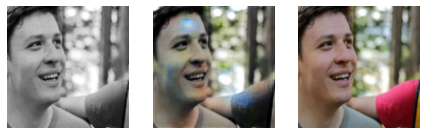

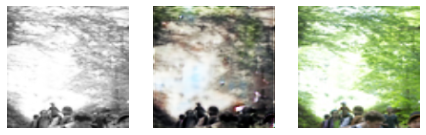

 98%|█████████▊| 147/150 [35:52<00:44, 14.68s/it]

0.04931117966771126


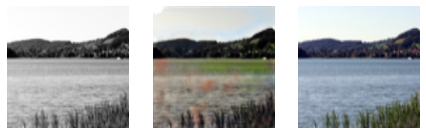

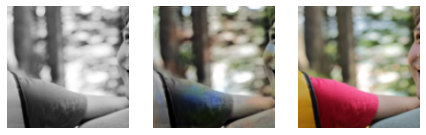

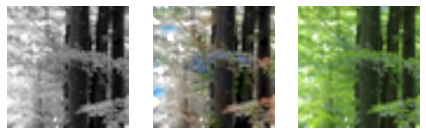

 99%|█████████▊| 148/150 [36:07<00:29, 14.69s/it]

0.04575388878583908


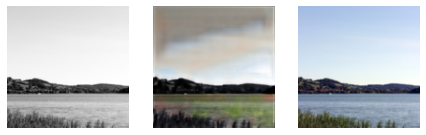

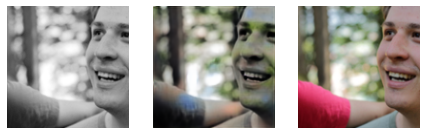

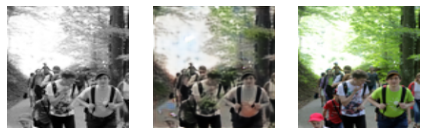

 99%|█████████▉| 149/150 [36:21<00:14, 14.72s/it]

0.04192187264561653


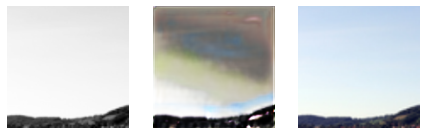

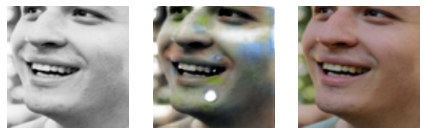

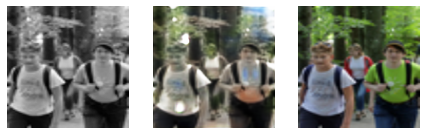

100%|██████████| 150/150 [36:36<00:00, 14.64s/it]


In [14]:
history = []
for epoch in tqdm(range(num_epochs)):
    for x, y in loader:
        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()
        colorized = model(x)

        loss = criterion(colorized, y)
        history.append(loss.item())

        loss.backward()
        optimizer.step()

    print(history[-1])

    for t in (201, 303, 307):
        img_gray, img_true = dataset[t]
        img_pred = model(img_gray.to(device).view(1, 1, 128, 128))
        img_pred = to_numpy_image(img_pred)
        # теперь это numpy-евский ndarray размера (128, 128, 3)
        plt.figure(figsize=(10,10))
        
        plt.subplot(141)
        plt.axis('off')
        plt.set_cmap('Greys')
        plt.imshow(img_gray.reshape((128, 128)))

        plt.subplot(142)
        plt.axis('off')
        plt.imshow(img_pred.reshape((128, 128, 3)))

        plt.subplot(143)
        plt.axis('off')
        plt.imshow(to_numpy_image(img_true))
    
    plt.show()

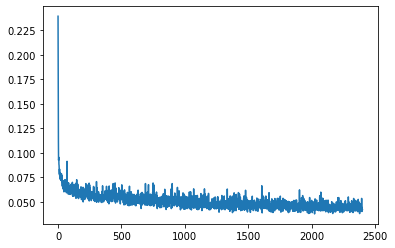

In [15]:
plt.plot(history)
plt.show()

В подобных нечётко поставленных задачах важно смотреть не цифры, а на реальные примеры.


In [12]:
def to_numpy_image(img):
    # tl;dr: PyTorch хочет (3, 128, 128), а plt.imshow хочет (128, 128, 3)
    # есть два популярных формата для цветных картинок:
    #  1. где размерность, соответствующая каналам, идёт последней
    #  2. где размерность, соответствующая каналам, идёт первой
    # при работе с нейросетями удобен первый подход -- так запрашиваемая
    # при вычислениях память идёт последовательно, и из-за кэширования
    # операции свёртки работают быстрее
    # второй подход удобнее при уже работе с устройством, которое эти картинки показывает
    # -- удобно на три лампочки послать сразу три последовательно идущих байта
    return img.detach().cpu().view(3, 128, 128).transpose(0, 1).transpose(1, 2).numpy()

200


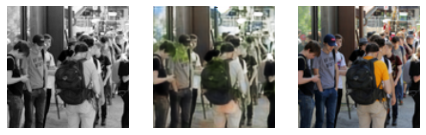

201


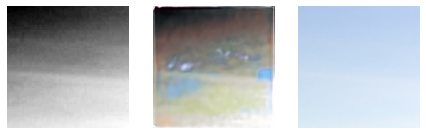

202


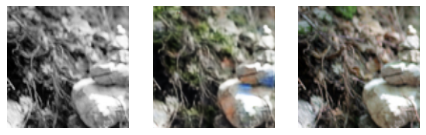

203


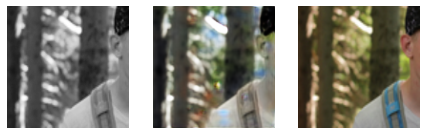

204


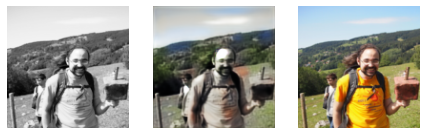

205


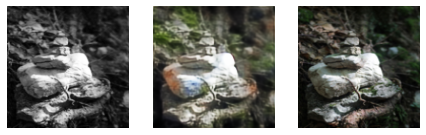

206


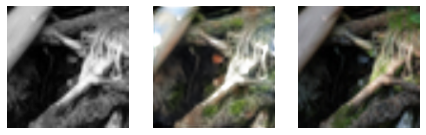

207


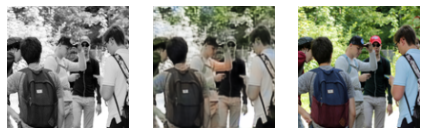

208


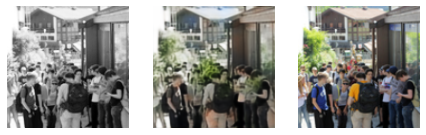

209


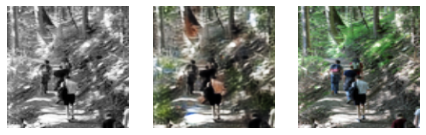

210


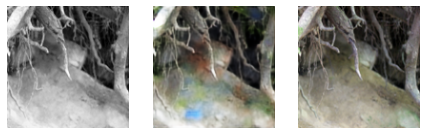

211


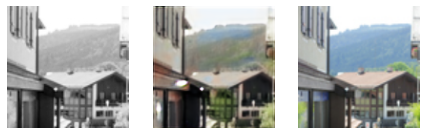

212


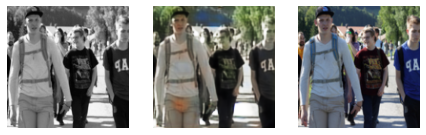

213


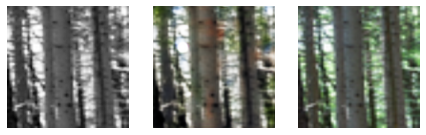

214


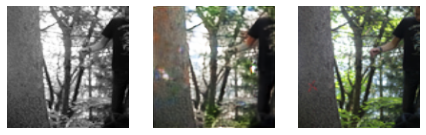

215


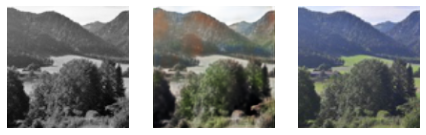

216


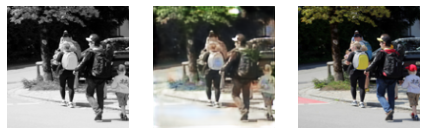

217


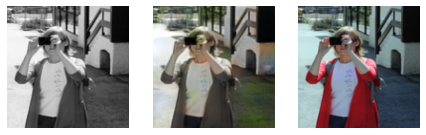

218


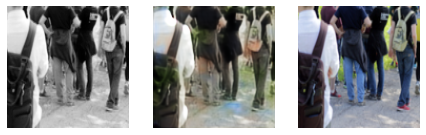

219


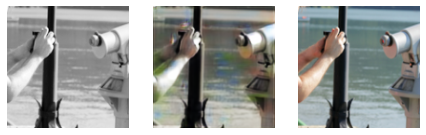

220


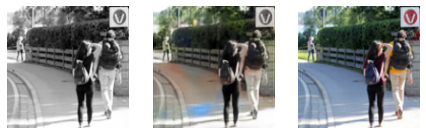

In [16]:
for t in range(200, 221):
    img_gray, img_true = dataset[t]
    img_pred = model(img_gray.to(device).view(1, 1, 128, 128))
    img_pred = to_numpy_image(img_pred)
    # теперь это numpy-евский ndarray размера (128, 128, 3)
    plt.figure(figsize=(10,10))
    
    plt.subplot(141)
    plt.axis('off')
    plt.set_cmap('Greys')
    plt.imshow(img_gray.reshape((128, 128)))

    plt.subplot(142)
    plt.axis('off')
    plt.imshow(img_pred.reshape((128, 128, 3)))

    print(t)
    plt.subplot(143)
    plt.axis('off')
    plt.imshow(to_numpy_image(img_true))
    
    plt.show()

## *Тизер: adversarial loss

У нашего подхода к колоризации есть одна весьма существенная проблема: непонятно, как определять функцию потерь. Выясняется, что l1 или l2 в некоторых случаях даже являются принципиально неправильным выбором. Представьте, что у нас есть датасет фотографий с летнего лагеря, в котором все люди ходят в футболках двух разных цветов — например, красного и синего — интенсивность которых одинакова и неотличима на черно-белых версиях. Тогда наш лосс заставит сеть выбирать что-то «по середине» (в случае с l2 это будет среднее, а с l1 медиана), и, скорее всего, она сгенерирует что-то серое, в то время как она должна с какой-то вероятностью сгенерировать явно красную или явно синюю футболку.

Решение в следующем: выход (колоризованное изображение) кормить в другую сеть, которая учится определять «правдоподобность» раскраски. Помимо восстановления изображения с точки зрения какой-то меры близости, сети-генератору (колоризатору) нужно ещё и обмануть сеть-дискриминатор, а сети-дискриминатору нужно наоборот, учиться отличать настоящую колоризацию от нашей.

Подобные схемы с двумя состязяющимися сетями называют GAN-ам (Generative Adversarial Networks), о которых мы поговорим через занятие.